In [22]:
!pip install -q git+https://github.com/tensorflow/examples.git

/opt/conda/lib/python3.10/pty.py:89: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  pid, fd = os.forkpty()


# Libraries

In [23]:
# Main libs
import random
import tensorflow as tf
from tensorflow import keras

# Data Imports
import os
import pandas as pd
from glob import glob
import tensorflow.data as tfd

# Data Visualization
from PIL import Image
import plotly.express as px
import matplotlib.pyplot as plt
from IPython.display import Image as GIF

# Unet Architecture
from tensorflow.keras import layers
from tensorflow_examples.models.pix2pix import pix2pix

# Configurations

In [24]:
# Configuration for Data
BATCH_SIZE = 16
IMAGE_SIZE = (128, 128)
IMAGE_DIRECTORY = "/kaggle/input/augmented-forest-segmentation/Forest Segmented/Forest Segmented/images/"
MASK_DIRECTORY = "/kaggle/input/augmented-forest-segmentation/Forest Segmented/Forest Segmented/masks/"

# Settings for Reproducibility
SEED = 42
BATCH_SIZE = 32
VALIDATION_SIZE = 1000
AUTOTUNE = tfd.AUTOTUNE
tf.random.set_seed(SEED)

# Loading Dataset

In [25]:
def decode_image(file_path):
    """
    Load and preprocess an image from the provided file path.

    Args:
        file_path (str): Path to the image file.

    Returns:
        tf.Tensor: The preprocessed image tensor.
    """
    image = tf.io.read_file(file_path)
    image = tf.image.decode_jpeg(image, channels=3)
    image = tf.image.convert_image_dtype(image, tf.float32)
    image = tf.image.resize(image, IMAGE_SIZE)
    image = tf.clip_by_value(image, clip_value_min=0.0, clip_value_max=1.0)
    return image

def decode_masks(file_path):
    """
    Load and preprocess a mask image from the given file path.

    Args:
        file_path (str): Path to the mask image file.

    Returns:
        tf.Tensor: The preprocessed mask image tensor.
    """
    mask_image = decode_image(file_path)
    mask_image = mask_image[:, :, :1]  # Retain only the first channel for binary masks
    return mask_image

def show_image(image, title=None, alpha=1):
    """
    Display an image with an optional title and transparency.

    Args:
        image (tf.Tensor): The image tensor to display.
        title (str, optional): The title for the image. Defaults to None.
        alpha (float, optional): Transparency value of the image. Defaults to 1.
    """
    plt.imshow(image, alpha=alpha)
    plt.title(title)
    plt.axis('off')

def show_image_masks(dataset, n_rows=5, n_cols=3, figsize=(10, 15)):
    """
    Display a grid of images and corresponding masks from a dataset.

    Args:
        dataset (tf.data.Dataset): The dataset containing image and mask pairs.
        n_rows (int, optional): Number of rows in the grid. Defaults to 5.
        n_cols (int, optional): Number of columns in the grid. Defaults to 3.
        figsize (tuple, optional): Size of the plot figure. Defaults to (10, 15).
    """
    images, masks = next(iter(dataset.take(1)))

    plt.figure(figsize=figsize)
    for i in range(1, (n_rows * n_cols) + 1, n_cols):
        plt.subplot(n_rows, n_cols, i)
        show_image(images[i], title="Aerial Imagery")

        plt.subplot(n_rows, n_cols, i + 1)
        show_image(masks[i], title="Image Mask")

        plt.subplot(n_rows, n_cols, i + 2)
        show_image(images[i])
        show_image(masks[i], alpha=0.5, title="Overlay")

    plt.show()


In [26]:
# Load the metadata
metadata = pd.read_csv("/kaggle/input/augmented-forest-segmentation/meta_data.csv")
metadata.image = metadata.image.apply(lambda file_name: f"{IMAGE_DIRECTORY}{file_name}")
metadata['mask'] = metadata['mask'].apply(lambda file_name: f"{MASK_DIRECTORY}{file_name}")


In [27]:
# Transform the data into TensorFlow datasets
image_files = tfd.Dataset.from_tensor_slices(metadata['image'])
mask_files = tfd.Dataset.from_tensor_slices(metadata['mask'])

# Decode image files into image tensors
images = image_files.map(decode_image)
masks = mask_files.map(decode_masks)

# Combine images and masks into a single dataset
dataset = tf.data.Dataset.zip((images, masks))
dataset = dataset.repeat(2).shuffle(1000).batch(BATCH_SIZE)

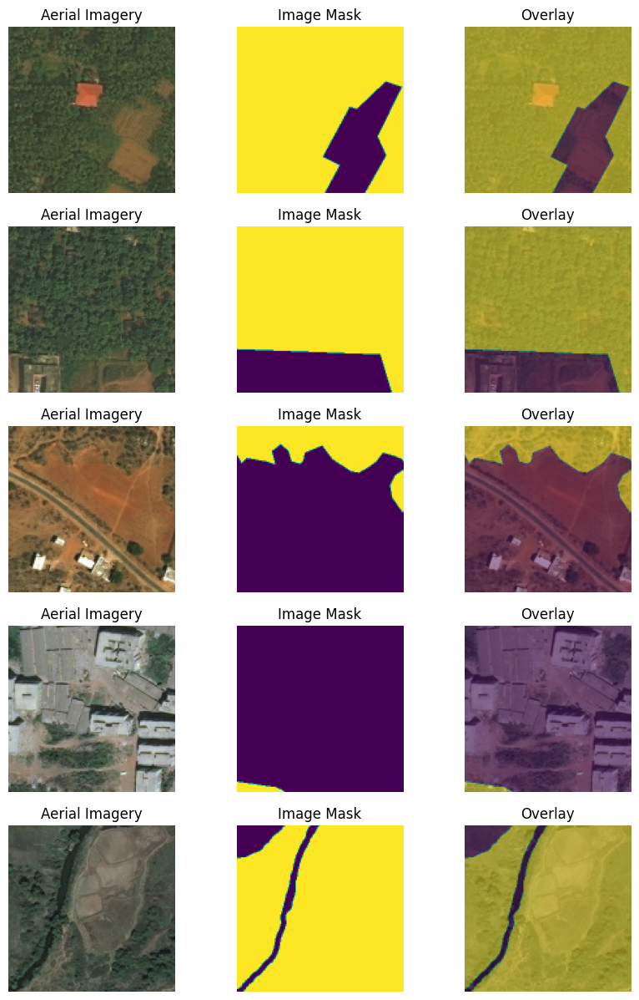

In [28]:
show_image_masks(dataset)

# Data Augmentation

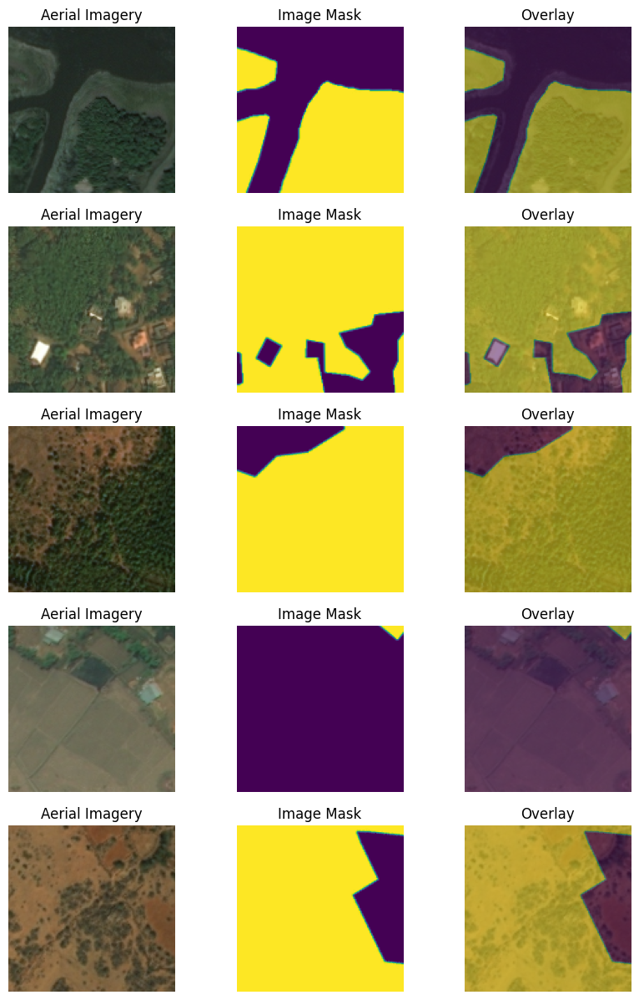

In [29]:
class Augment(layers.Layer):
    """
    Custom layer for data augmentation of images and masks.

    Args:
        seed (int): Random seed for reproducibility. Defaults to 42.
    """
    def __init__(self, seed=42):
        super().__init__()
        
        self.augment_images = tf.keras.Sequential([
            layers.RandomRotation(0.3, seed=seed),
            layers.RandomFlip(mode="horizontal", seed=seed),
        ])
        
        self.augment_masks = tf.keras.Sequential([
            layers.RandomRotation(0.3, seed=seed),
            layers.RandomFlip(mode="horizontal", seed=seed),
        ])
            
    def call(self, inputs, labels):
        """
        Apply data augmentation to images and masks.

        Args:
            inputs (tf.Tensor): Input images tensor.
            labels (tf.Tensor): Input masks tensor.

        Returns:
            tuple: Tuple containing augmented images and masks tensors.
        """
        inputs = self.augment_images(inputs)
        labels = self.augment_masks(labels)
        return inputs, labels
# Apply data augmentation
augmented_ds = dataset.map(Augment(SEED)).cache().prefetch(AUTOTUNE)

# A quick look
show_image_masks(augmented_ds)

In [30]:
# Calculate the total number of samples in the dataset
total_samples = len(augmented_ds)

# Print the total number of samples
print("Total number of samples in the augmented dataset:", total_samples * BATCH_SIZE)

Total number of samples in the augmented dataset: 10240


In [31]:
# Splitting into Training and validation
valid_ds = augmented_ds.take(VALIDATION_SIZE//BATCH_SIZE).prefetch(AUTOTUNE)
train_ds = augmented_ds.skip(VALIDATION_SIZE//BATCH_SIZE).prefetch(AUTOTUNE)

train_samples = tfd.experimental.cardinality(train_ds).numpy() * BATCH_SIZE
valid_samples = tfd.experimental.cardinality(valid_ds).numpy() * BATCH_SIZE

print("Training   Samples:", train_samples)
print("Validation Samples:", valid_samples)

Training   Samples: 9248
Validation Samples: 992


In [32]:
# Loading the base model
base_model = keras.applications.MobileNetV2(
    input_shape=(*IMAGE_SIZE, 3),
    include_top=False
)

# Use the activations of these layers
layer_names = [
    'block_1_expand_relu',   # 64x64
    'block_3_expand_relu',   # 32x32
    'block_6_expand_relu',   # 16x16
    'block_13_expand_relu',  # 8x8
    'block_16_project',      # 4x4
]

base_model_outputs = [base_model.get_layer(name).output for name in layer_names]

# Initialize the encoder model (Downsampling block)
encoder = keras.Model(
    inputs=base_model.input,
    outputs=base_model_outputs,
    name="Encoder"
)

# Freeze the model weights
encoder.trainable = False

In [33]:
# Decoder (Up-sampling block)
decoder = [
    pix2pix.upsample(512, 3),  # 4x4 -> 8x8
    pix2pix.upsample(256, 3),  # 8x8 -> 16x16
    pix2pix.upsample(128, 3),  # 16x16 -> 32x32
    pix2pix.upsample(64, 3),   # 32x32 -> 64x64
]

# Partial Cross Entropy Function:

$$ \text{pfCE} = \frac{\sum_{i} \text{CE}(p_i, y_i) \times \text{mask}_i}{\sum_{i} \text{mask}_i} $$

where:
- \text{CE} is the standard cross-entropy loss between predicted logits \( p_i \) and ground truth labels \( y_i \).
- \({mask}_i \) is a binary mask indicating labeled points.



In [34]:
def partial_cross_entropy(y_true, y_pred):
    # Define your partial cross entropy loss calculation
    # Ensure y_true and y_pred are appropriately handled
    # Example:
    loss = tf.reduce_mean(tf.nn.sigmoid_cross_entropy_with_logits(labels=y_true, logits=y_pred))
    return loss

**Registering the function a TF decorator is recommended**

In [35]:
@tf.function
def partial_cross_entropy(y_true, y_pred):
    # Define your partial cross entropy loss calculation
    # Ensure y_true and y_pred are appropriately handled
    # Example:
    loss = tf.reduce_mean(tf.nn.sigmoid_cross_entropy_with_logits(labels=y_true, logits=y_pred))
    return loss
    pass  # Example implementation


In [36]:
def CustomUNet(encoder_block, decoder_block, output_channels=1, **kwargs):
    """
    Custom U-Net model for semantic segmentation.

    Args:
        encoder_block (tf.keras.Model): Encoder block of the U-Net model.
        decoder_block (list): List of decoder blocks for the U-Net model.
        output_channels (int, optional): Number of output channels/classes. Defaults to 3.
        **kwargs: Additional keyword arguments passed to the base class constructor.

    Returns:
        tf.keras.Model: U-Net model for semantic segmentation.
    """
    # Input layer
    inputs = keras.Input(shape=(*IMAGE_SIZE, 3), name="ImageInput")

    # Pass it through the encoder
    encodings = encoder_block(inputs)
    skips = reversed(encodings[:-1])        
    encoding = encodings[-1]

    # Upsampling and Skip connections
    for index, (up, skip) in enumerate(zip(decoder_block, skips)):
        encoding = up(encoding)
        encoding = layers.Concatenate(name=f"ConCat-{index+1}")([encoding, skip])

    # The Output layer
    mask_out = layers.Conv2DTranspose(
        filters=1,
        kernel_size=3,
        strides=2,
        padding="same",
    )(encoding)
    
    mask_out = layers.Conv2D(
        filters=1,
        kernel_size=1,
        padding="same",
        activation='sigmoid',
        name="MaskOut"
    )(mask_out)

    # Define the model
    model = keras.Model(inputs, mask_out, **kwargs)
    
    return model

In [37]:
# Initialize model
model = CustomUNet(encoder, decoder, name="CustomUNet")

# Model architecture
model.summary()

Model: "CustomUNet"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ ImageInput          │ (None, 128, 128,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ Encoder             │ [(None, 64, 64,   │  1,841,984 │ ImageInput[0][0]  │
│ (Functional)        │ 96), (None, 32,   │            │                   │
│                     │ 32, 144), (None,  │            │                   │
│                     │ 16, 16, 192),     │            │                   │
│                     │ (None, 8, 8,      │            │                   │
│                     │ 576), (None, 4,   │            │                   │
│                     │ 4, 320)]          │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ sequential_8        │ (None, 8, 8, 512) │  1,476,608 │ Encoder[0][4]     │
│ (Sequential)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ ConCat-1            │ (None, 8, 8,      │          0 │ sequential_8[0][… │
│ (Concatenate)       │ 1088)             │            │ Encoder[0][3]     │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ sequential_9        │ (None, 16, 16,    │  2,507,776 │ ConCat-1[0][0]    │
│ (Sequential)        │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ ConCat-2            │ (None, 16, 16,    │          0 │ sequential_9[0][… │
│ (Concatenate)       │ 448)              │            │ Encoder[0][2]     │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ sequential_10       │ (None, 32, 32,    │    516,608 │ ConCat-2[0][0]    │
│ (Sequential)        │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ ConCat-3            │ (None, 32, 32,    │          0 │ sequential_10[0]… │
│ (Concatenate)       │ 272)              │            │ Encoder[0][1]     │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ sequential_11       │ (None, 64, 64,    │    156,928 │ ConCat-3[0][0]    │
│ (Sequential)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ ConCat-4            │ (None, 64, 64,    │          0 │ sequential_11[0]… │
│ (Concatenate)       │ 160)              │            │ Encoder[0][0]     │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_transpose_9  │ (None, 128, 128,  │      1,441 │ ConCat-4[0][0]    │
│ (Conv2DTranspose)   │ 1)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ MaskOut (Conv2D)    │ (None, 128, 128,  │          2 │ conv2d_transpose… │
│                     │ 1)                │            │                   │
└─────────────────────┴───────────────────┴────────────┴───────────────────┘

 Total params: 6,501,347 (24.80 MB)

 Trainable params: 4,657,443 (17.77 MB)

 Non-trainable params: 1,843,904 (7.03 MB)

# Training

In [38]:
def show_pred_masks(dataset, model, n_rows=5, n_cols=6, figsize=(15, 15), savepath=None):
    """
    Display a grid of images, their true masks, and predicted masks from the given dataset using the provided model.

    Args:
        dataset (tf.data.Dataset): The dataset containing pairs of images and masks.
        model (tf.keras.Model): The trained model for predicting masks.
        n_rows (int, optional): Number of rows in the grid. Defaults to 5.
        n_cols (int, optional): Number of columns in the grid. Defaults to 3.
        figsize (tuple, optional): Figure size of the plot. Defaults to (10, 15).
        savepath (str, optional): Path to save the figure. Defaults to None.
    """
    images, masks = next(iter(dataset.take(1)))
    pred_masks = model.predict(images)

    plt.figure(figsize=figsize)
    for i in range(1, (n_rows * n_cols) + 1, n_cols):
        
        plt.subplot(n_rows, n_cols, i)
        show_image(images[i], title="Aerial Imagery")

        plt.subplot(n_rows, n_cols, i + 1)
        show_image(masks[i], title="True Image Mask")

        plt.subplot(n_rows, n_cols, i + 2)
        show_image(pred_masks[i], title="Predicted Image Mask")
        
        plt.subplot(n_rows, n_cols, i + 3)
        show_image(tf.cast(pred_masks[i]>=0.5, tf.float32), title="Processed Mask(0.5)")
        
        plt.subplot(n_rows, n_cols, i + 4)
        show_image(tf.cast(pred_masks[i]>=0.7, tf.float32), title="Processed Mask(0.7)")
        
        plt.subplot(n_rows, n_cols, i + 5)
        show_image(images[i])
        show_image(pred_masks[i], alpha=0.5, title="Overlapping")
        
        
    if savepath is not None:
        plt.savefig(savepath)
        
    plt.show()


class ShowImageMasksCallback(keras.callbacks.Callback):
    """
    Callback to visualize the model's predicted masks on the validation dataset at the end of each epoch.

    Args:
        dataset (tf.data.Dataset): The validation dataset containing pairs of images and masks.
    """
    def __init__(self, dataset):
        super().__init__()
        self.dataset = dataset

    def on_epoch_end(self, epoch, logs=None):
        """
        Display the predicted masks on the validation dataset at the end of each epoch.

        Args:
            epoch (int): Current epoch number.
            logs (dict): Dictionary containing training metrics for the current epoch.
        """
        show_pred_masks(dataset=self.dataset, n_rows=3, model=self.model, savepath=f"ModelPred_Epoch_{epoch}.png", figsize=(15, 10))

# IOU Function

In [39]:
# Define custom IOU metric function
def calculate_iou(y_true, y_pred):
    # Assuming y_true and y_pred are binary masks
    y_true = tf.cast(y_true > 0.5, tf.float32)
    y_pred = tf.cast(y_pred > 0.5, tf.float32)
    
    intersection = tf.reduce_sum(y_true * y_pred)
    union = tf.reduce_sum(tf.cast(y_true + y_pred > 0, tf.float32))
    
    return intersection / (union + tf.keras.backend.epsilon())

# Training

Epoch 1/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/stepms/step - accuracy: 0.7113 - calculate_iou: 0.6200 - loss: 0.593


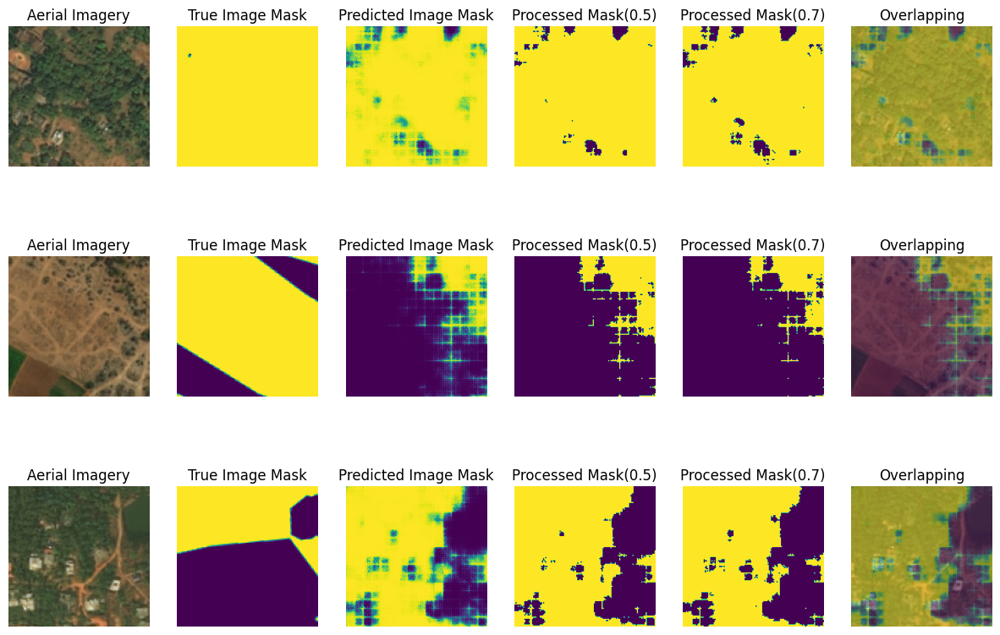

289/289 ━━━━━━━━━━━━━━━━━━━━ 55s 138ms/step - accuracy: 0.7114 - calculate_iou: 0.6202 - loss: 0.5933 - val_accuracy: 0.7527 - val_calculate_iou: 0.6744 - val_loss: 0.5612
Epoch 2/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/stepstep - accuracy: 0.7566 - calculate_iou: 0.6776 - loss: 0.569


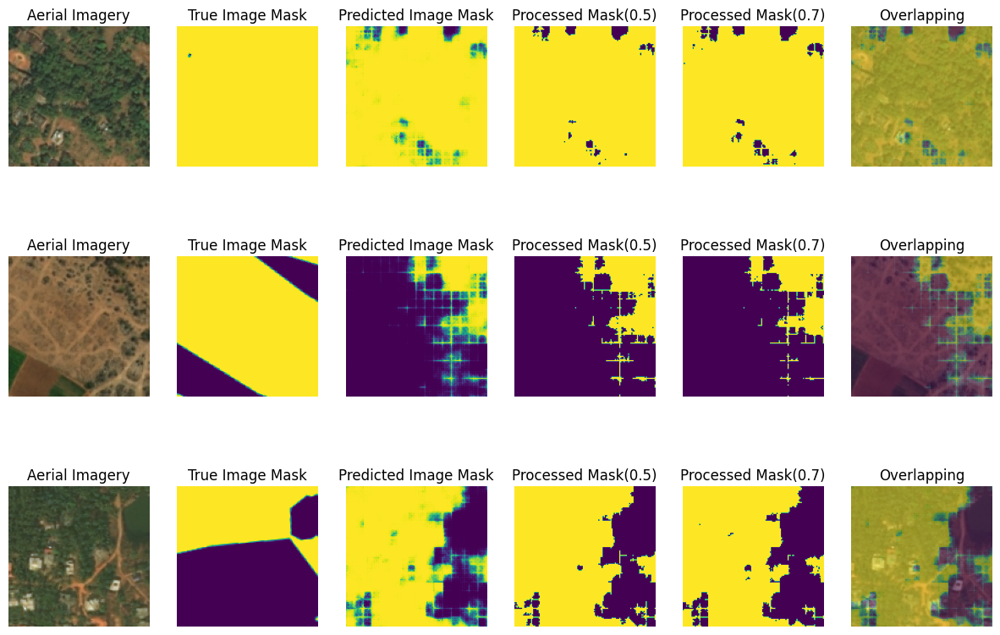

289/289 ━━━━━━━━━━━━━━━━━━━━ 12s 41ms/step - accuracy: 0.7566 - calculate_iou: 0.6777 - loss: 0.5693 - val_accuracy: 0.7614 - val_calculate_iou: 0.6878 - val_loss: 0.5585
Epoch 3/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/stepstep - accuracy: 0.7617 - calculate_iou: 0.6839 - loss: 0.566


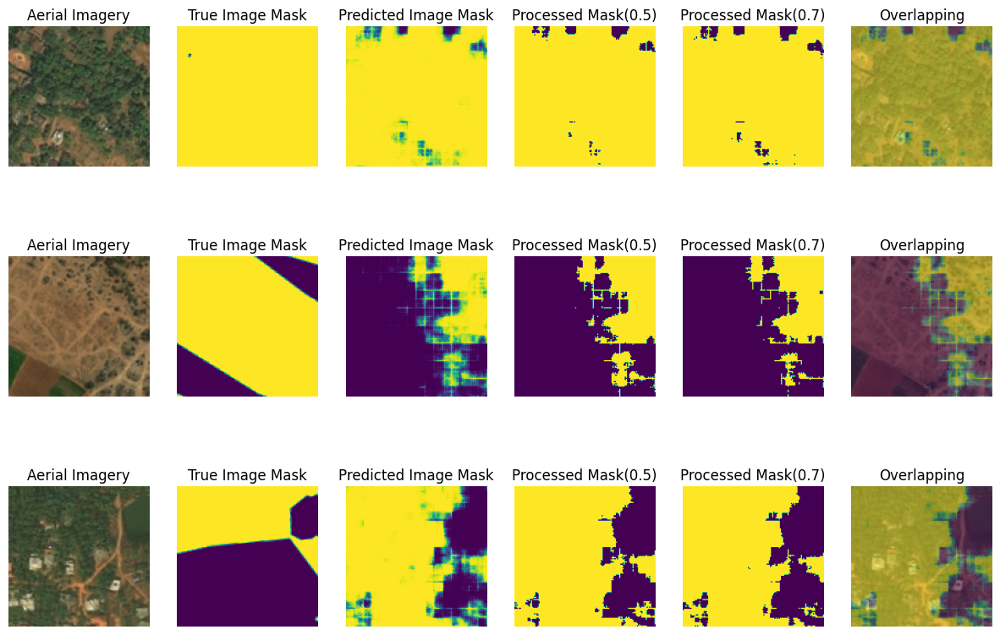

289/289 ━━━━━━━━━━━━━━━━━━━━ 12s 42ms/step - accuracy: 0.7618 - calculate_iou: 0.6840 - loss: 0.5667 - val_accuracy: 0.7688 - val_calculate_iou: 0.7004 - val_loss: 0.5565
Epoch 4/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/stepstep - accuracy: 0.7653 - calculate_iou: 0.6885 - loss: 0.565


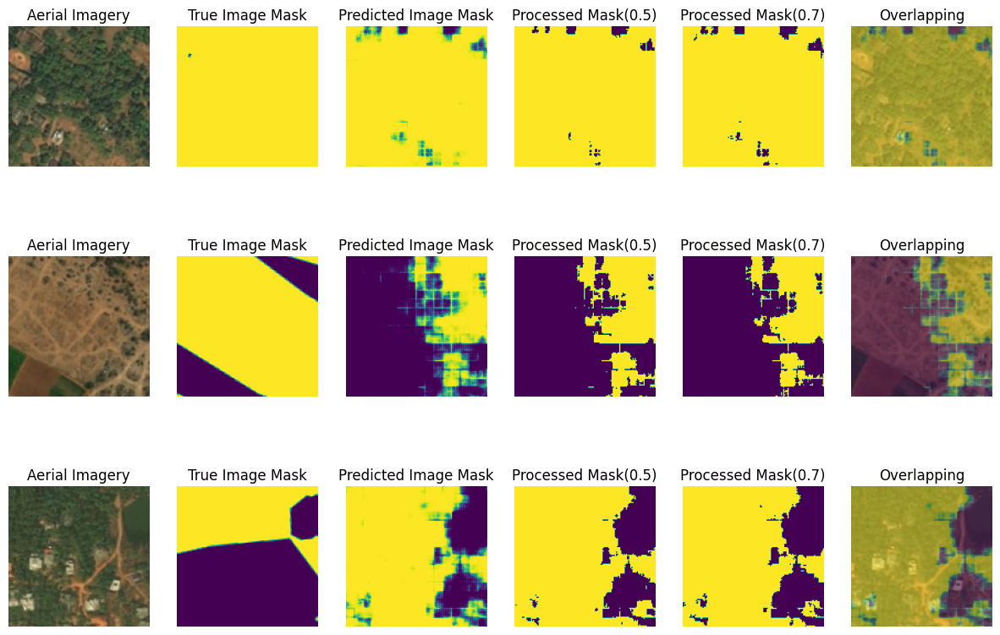

289/289 ━━━━━━━━━━━━━━━━━━━━ 12s 41ms/step - accuracy: 0.7654 - calculate_iou: 0.6885 - loss: 0.5650 - val_accuracy: 0.7737 - val_calculate_iou: 0.7096 - val_loss: 0.5559
Epoch 5/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/stepstep - accuracy: 0.7680 - calculate_iou: 0.6918 - loss: 0.563


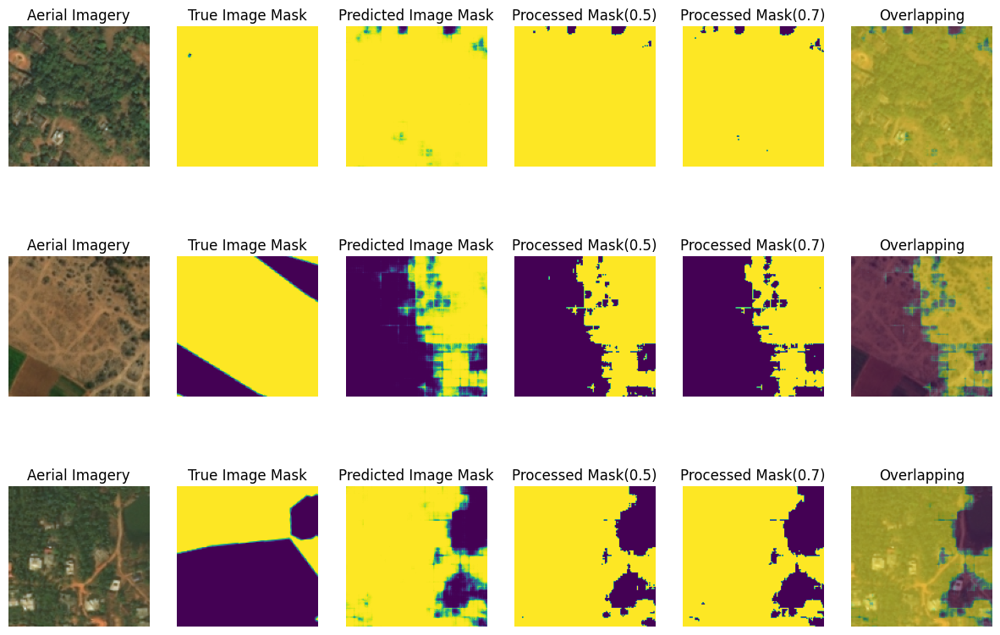

289/289 ━━━━━━━━━━━━━━━━━━━━ 12s 41ms/step - accuracy: 0.7680 - calculate_iou: 0.6919 - loss: 0.5638 - val_accuracy: 0.7806 - val_calculate_iou: 0.7252 - val_loss: 0.5567
Epoch 6/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/stepstep - accuracy: 0.7702 - calculate_iou: 0.6948 - loss: 0.562


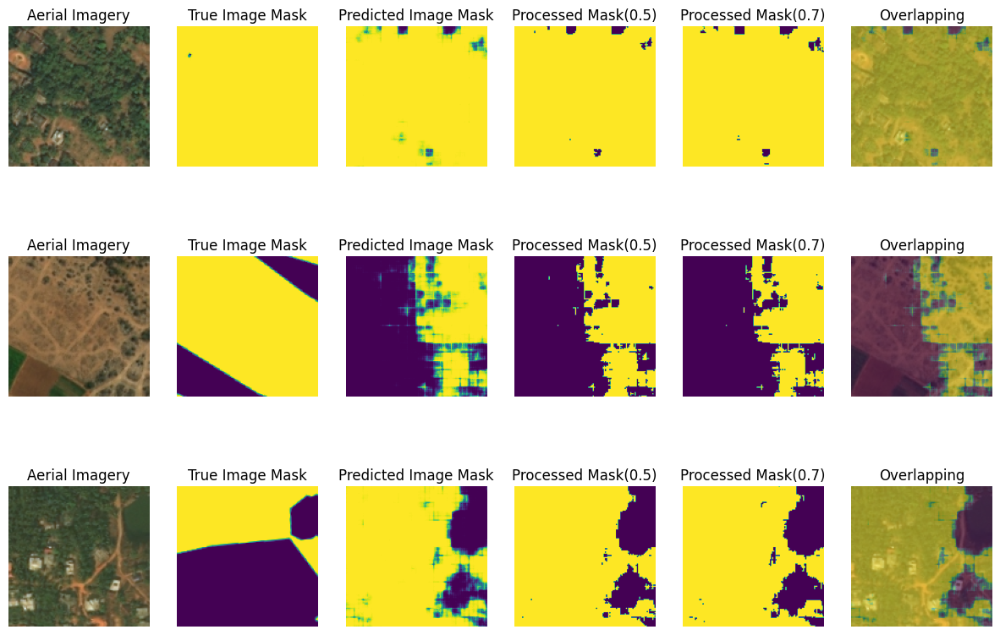

289/289 ━━━━━━━━━━━━━━━━━━━━ 12s 41ms/step - accuracy: 0.7703 - calculate_iou: 0.6949 - loss: 0.5628 - val_accuracy: 0.7799 - val_calculate_iou: 0.7228 - val_loss: 0.5561
Epoch 7/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/stepstep - accuracy: 0.7723 - calculate_iou: 0.6975 - loss: 0.561


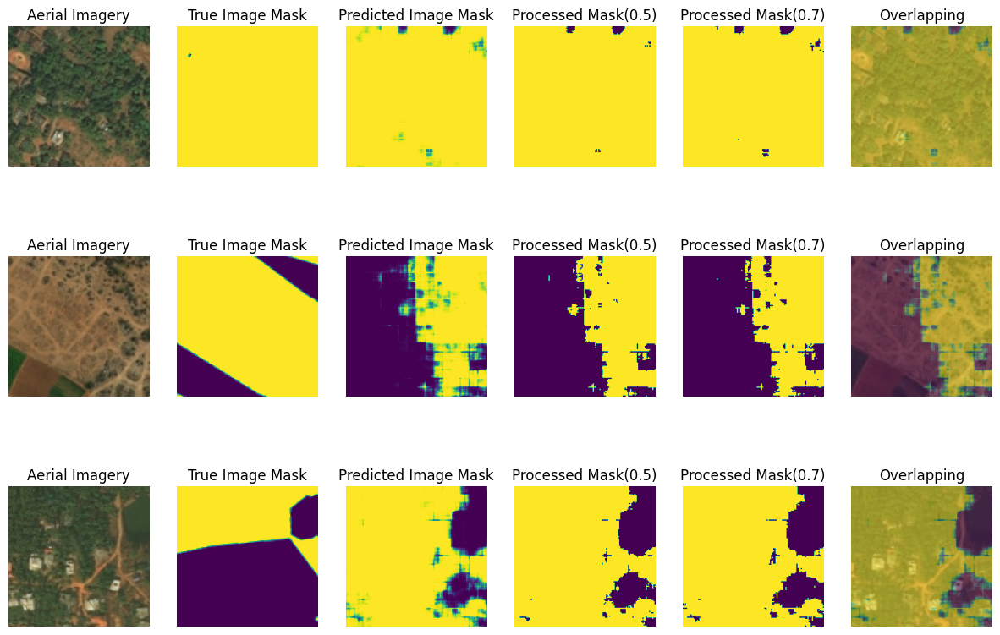

289/289 ━━━━━━━━━━━━━━━━━━━━ 12s 41ms/step - accuracy: 0.7723 - calculate_iou: 0.6975 - loss: 0.5619 - val_accuracy: 0.7818 - val_calculate_iou: 0.7278 - val_loss: 0.5569
Epoch 8/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/stepstep - accuracy: 0.7745 - calculate_iou: 0.7004 - loss: 0.560


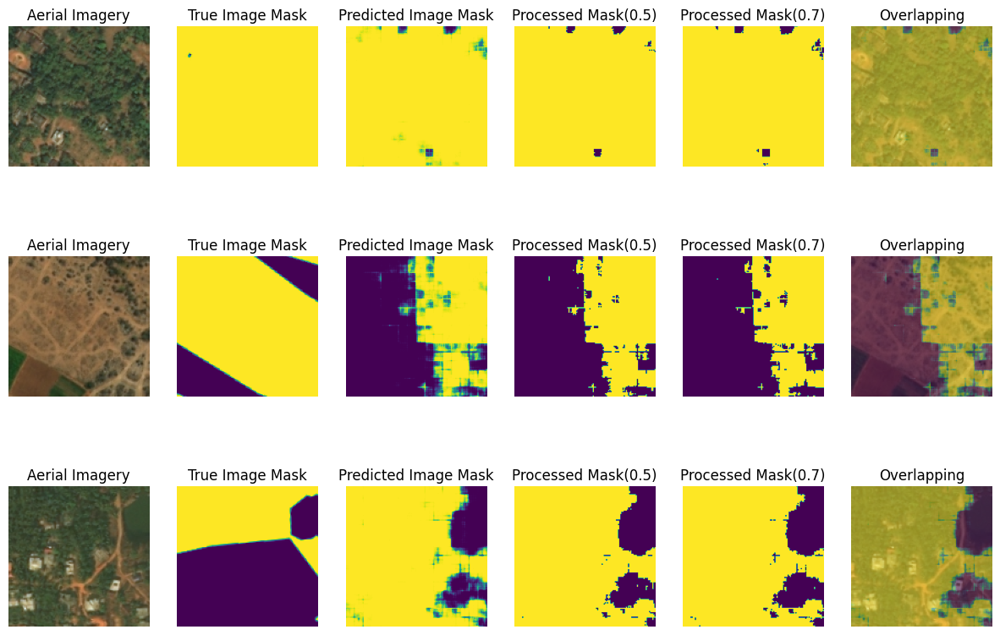

289/289 ━━━━━━━━━━━━━━━━━━━━ 12s 43ms/step - accuracy: 0.7746 - calculate_iou: 0.7005 - loss: 0.5608 - val_accuracy: 0.7829 - val_calculate_iou: 0.7281 - val_loss: 0.5557
Epoch 9/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/stepstep - accuracy: 0.7769 - calculate_iou: 0.7035 - loss: 0.559


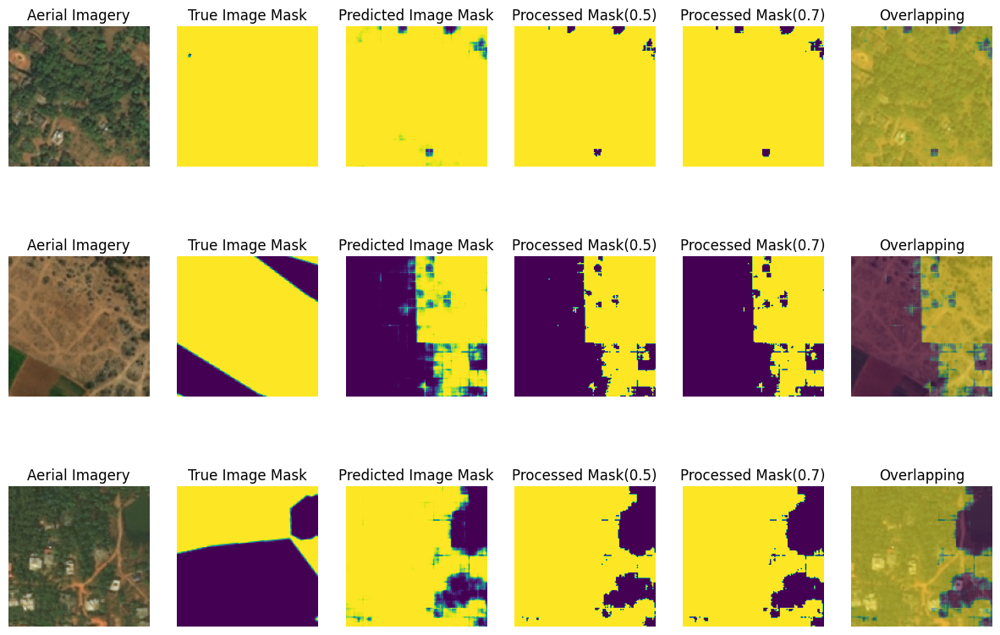

289/289 ━━━━━━━━━━━━━━━━━━━━ 12s 41ms/step - accuracy: 0.7769 - calculate_iou: 0.7035 - loss: 0.5597 - val_accuracy: 0.7834 - val_calculate_iou: 0.7283 - val_loss: 0.5551
Epoch 10/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/stepstep - accuracy: 0.7794 - calculate_iou: 0.7068 - loss: 0.558


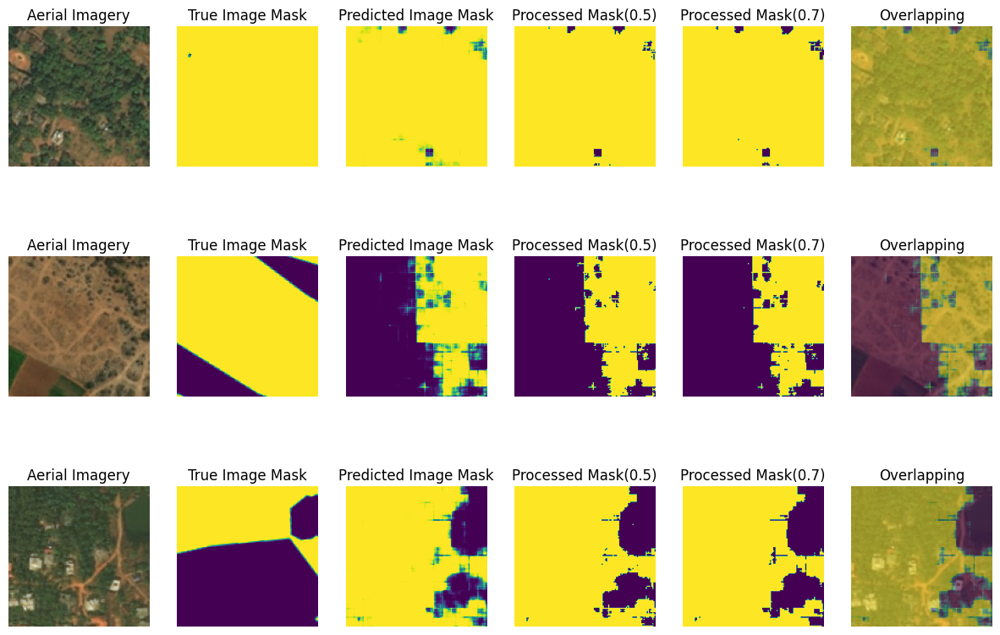

289/289 ━━━━━━━━━━━━━━━━━━━━ 12s 41ms/step - accuracy: 0.7794 - calculate_iou: 0.7069 - loss: 0.5586 - val_accuracy: 0.7837 - val_calculate_iou: 0.7280 - val_loss: 0.5547
Epoch 11/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/stepstep - accuracy: 0.7817 - calculate_iou: 0.7099 - loss: 0.557


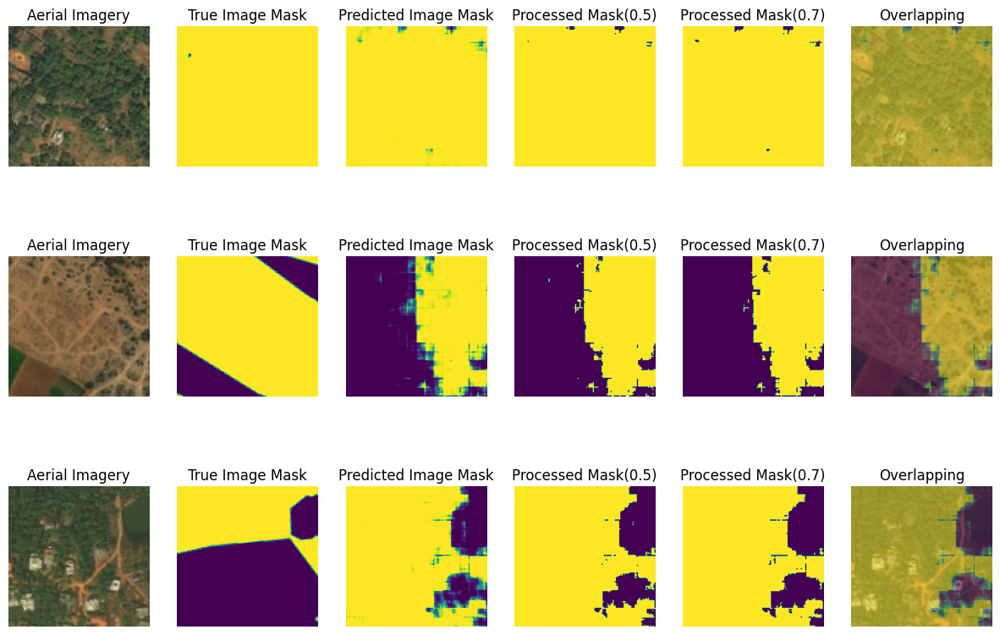

289/289 ━━━━━━━━━━━━━━━━━━━━ 12s 41ms/step - accuracy: 0.7818 - calculate_iou: 0.7100 - loss: 0.5576 - val_accuracy: 0.7854 - val_calculate_iou: 0.7335 - val_loss: 0.5560
Epoch 12/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/stepstep - accuracy: 0.7842 - calculate_iou: 0.7131 - loss: 0.556


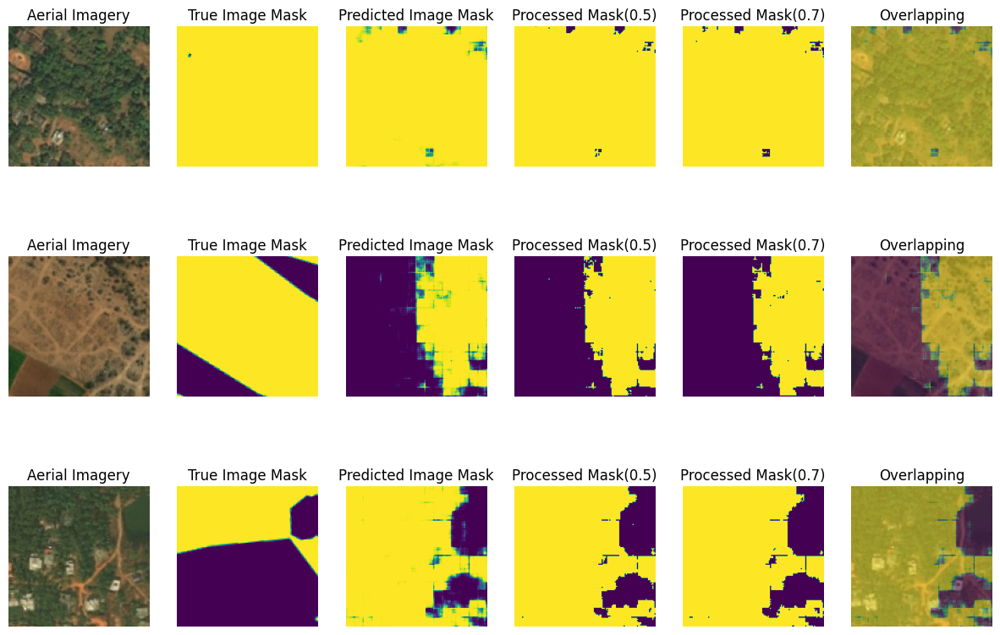

289/289 ━━━━━━━━━━━━━━━━━━━━ 12s 42ms/step - accuracy: 0.7842 - calculate_iou: 0.7132 - loss: 0.5565 - val_accuracy: 0.7849 - val_calculate_iou: 0.7298 - val_loss: 0.5544
Epoch 13/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/stepstep - accuracy: 0.7867 - calculate_iou: 0.7166 - loss: 0.555


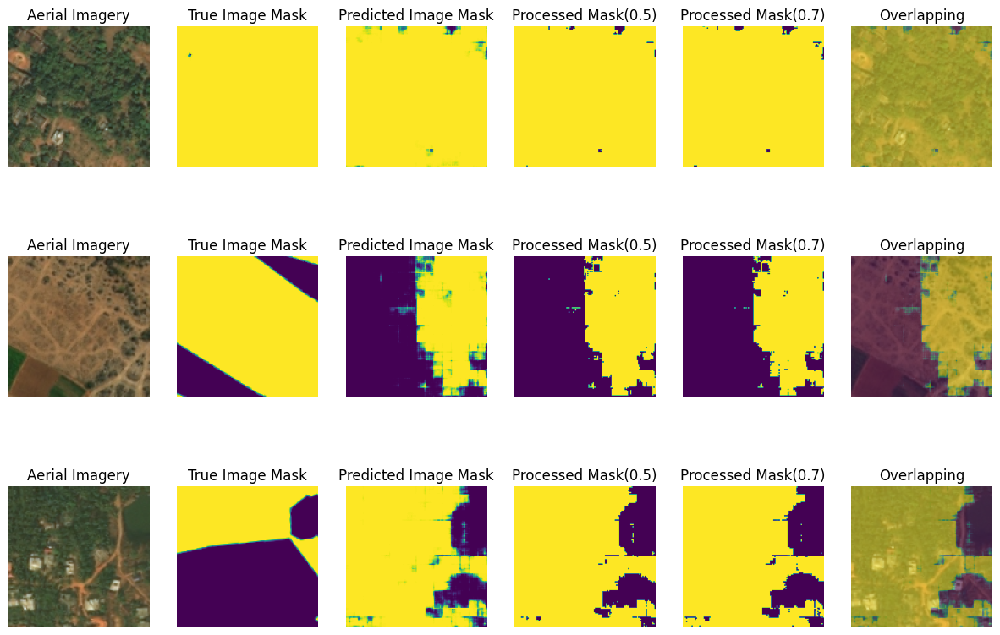

289/289 ━━━━━━━━━━━━━━━━━━━━ 13s 43ms/step - accuracy: 0.7868 - calculate_iou: 0.7166 - loss: 0.5553 - val_accuracy: 0.7853 - val_calculate_iou: 0.7299 - val_loss: 0.5540
Epoch 14/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/stepstep - accuracy: 0.7893 - calculate_iou: 0.7200 - loss: 0.554


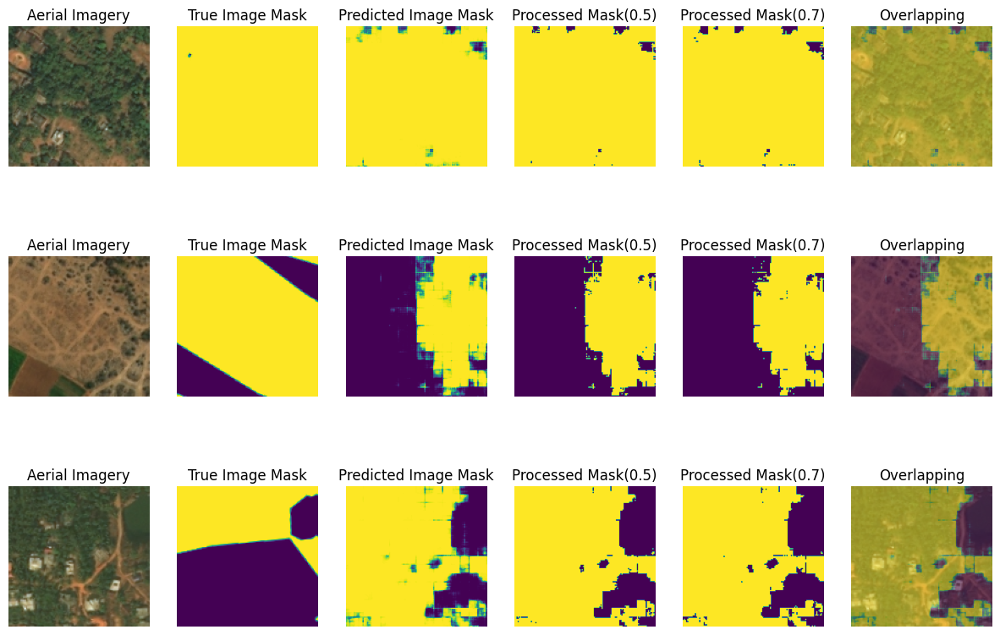

289/289 ━━━━━━━━━━━━━━━━━━━━ 12s 41ms/step - accuracy: 0.7893 - calculate_iou: 0.7201 - loss: 0.5542 - val_accuracy: 0.7846 - val_calculate_iou: 0.7275 - val_loss: 0.5535
Epoch 15/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/stepstep - accuracy: 0.7918 - calculate_iou: 0.7232 - loss: 0.553


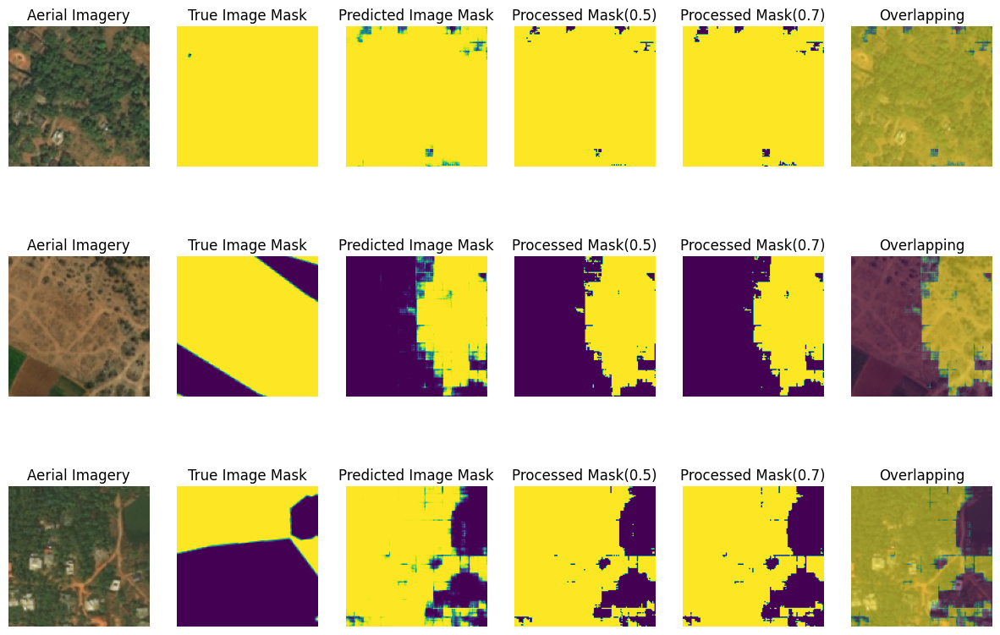

289/289 ━━━━━━━━━━━━━━━━━━━━ 12s 42ms/step - accuracy: 0.7918 - calculate_iou: 0.7232 - loss: 0.5530 - val_accuracy: 0.7839 - val_calculate_iou: 0.7249 - val_loss: 0.5528
Epoch 16/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/stepstep - accuracy: 0.7939 - calculate_iou: 0.7258 - loss: 0.552


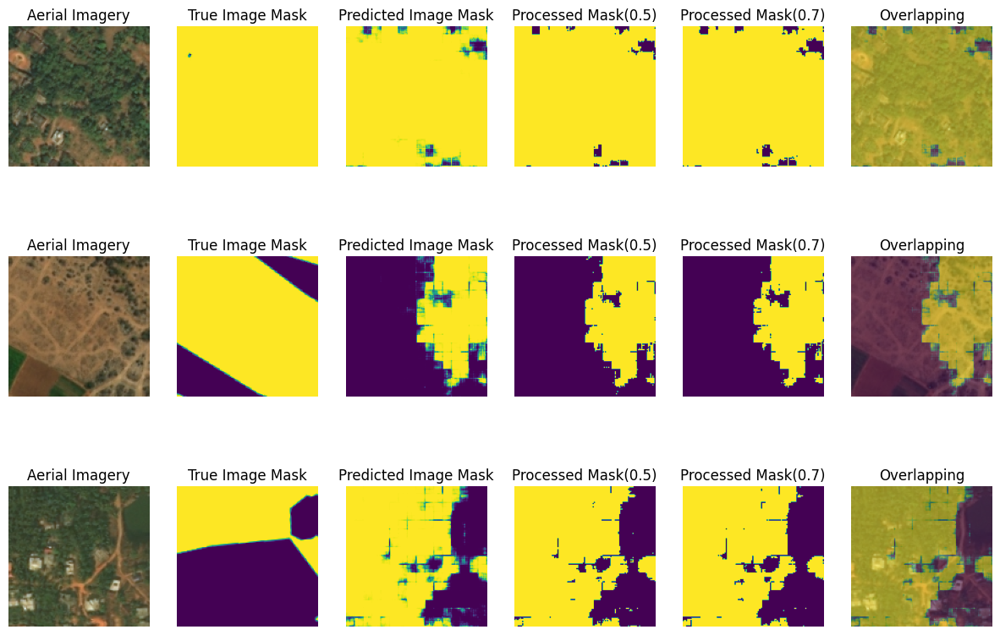

289/289 ━━━━━━━━━━━━━━━━━━━━ 12s 42ms/step - accuracy: 0.7939 - calculate_iou: 0.7259 - loss: 0.5519 - val_accuracy: 0.7785 - val_calculate_iou: 0.7129 - val_loss: 0.5523
Epoch 17/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/stepstep - accuracy: 0.7964 - calculate_iou: 0.7291 - loss: 0.550


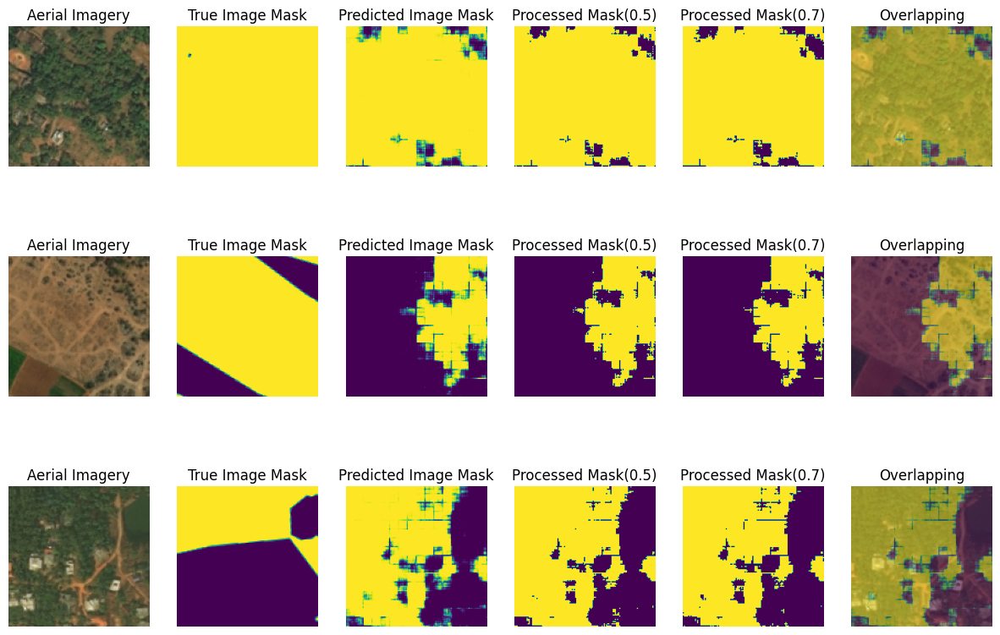

289/289 ━━━━━━━━━━━━━━━━━━━━ 12s 41ms/step - accuracy: 0.7964 - calculate_iou: 0.7292 - loss: 0.5508 - val_accuracy: 0.7668 - val_calculate_iou: 0.6918 - val_loss: 0.5543
Epoch 18/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/stepstep - accuracy: 0.7986 - calculate_iou: 0.7323 - loss: 0.549


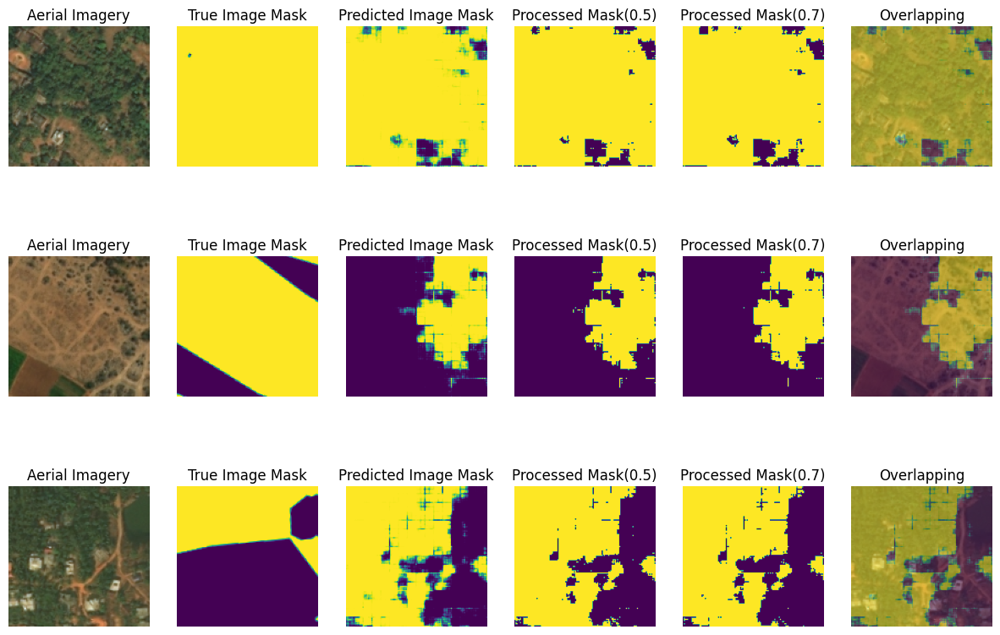

289/289 ━━━━━━━━━━━━━━━━━━━━ 13s 44ms/step - accuracy: 0.7987 - calculate_iou: 0.7323 - loss: 0.5498 - val_accuracy: 0.7645 - val_calculate_iou: 0.6876 - val_loss: 0.5548
Epoch 19/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/stepstep - accuracy: 0.8006 - calculate_iou: 0.7348 - loss: 0.548


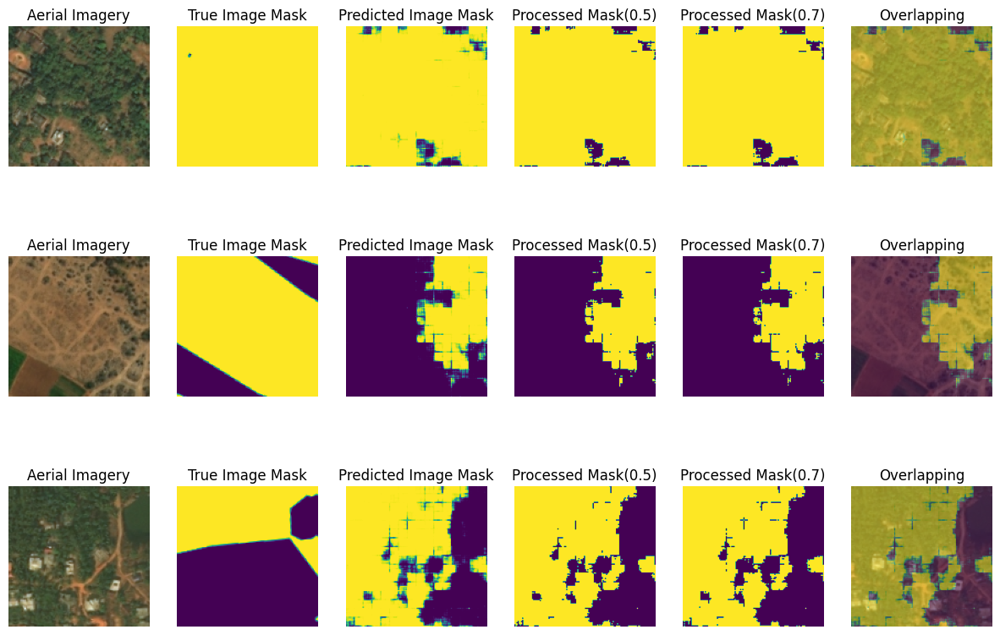

289/289 ━━━━━━━━━━━━━━━━━━━━ 12s 42ms/step - accuracy: 0.8006 - calculate_iou: 0.7349 - loss: 0.5488 - val_accuracy: 0.7689 - val_calculate_iou: 0.6951 - val_loss: 0.5537
Epoch 20/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/stepstep - accuracy: 0.8038 - calculate_iou: 0.7391 - loss: 0.547


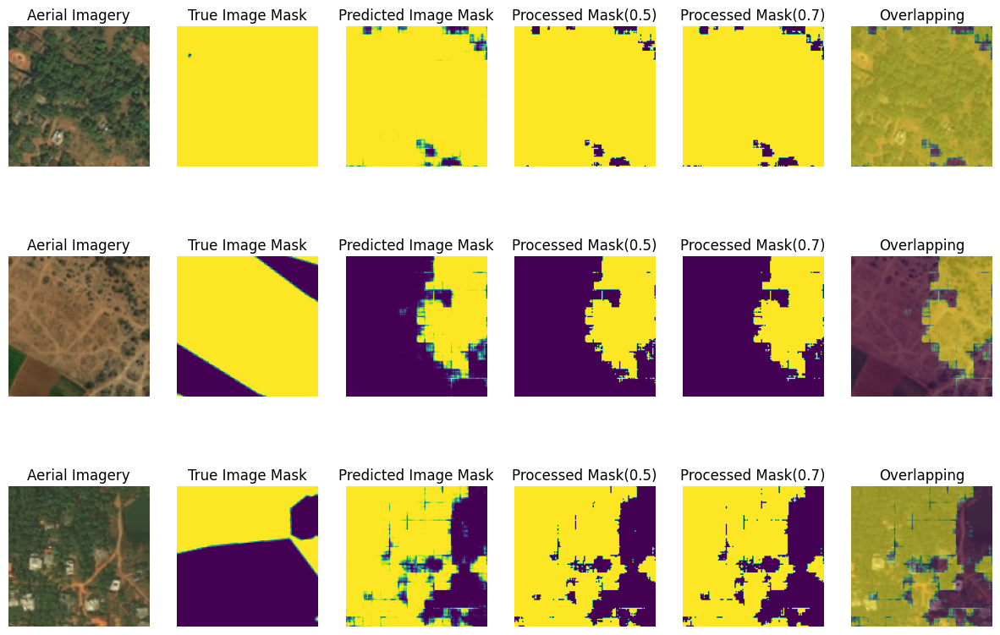

289/289 ━━━━━━━━━━━━━━━━━━━━ 12s 42ms/step - accuracy: 0.8038 - calculate_iou: 0.7391 - loss: 0.5473 - val_accuracy: 0.7794 - val_calculate_iou: 0.7140 - val_loss: 0.5518
Epoch 21/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/stepstep - accuracy: 0.8062 - calculate_iou: 0.7423 - loss: 0.546


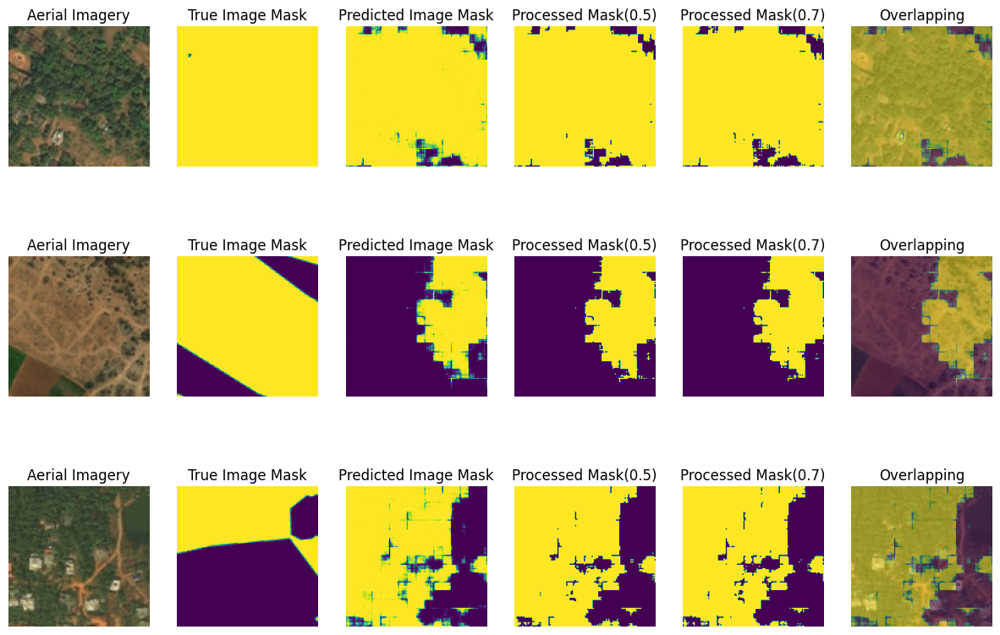

289/289 ━━━━━━━━━━━━━━━━━━━━ 12s 42ms/step - accuracy: 0.8062 - calculate_iou: 0.7423 - loss: 0.5462 - val_accuracy: 0.7689 - val_calculate_iou: 0.6951 - val_loss: 0.5537
Epoch 22/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/stepstep - accuracy: 0.8087 - calculate_iou: 0.7455 - loss: 0.544


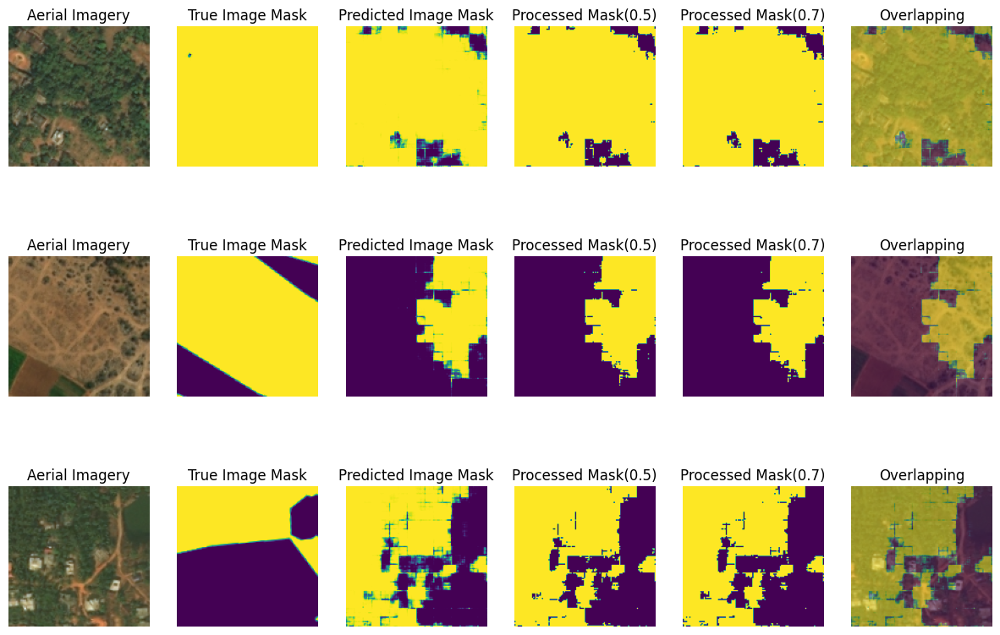

289/289 ━━━━━━━━━━━━━━━━━━━━ 12s 42ms/step - accuracy: 0.8087 - calculate_iou: 0.7456 - loss: 0.5449 - val_accuracy: 0.7678 - val_calculate_iou: 0.6929 - val_loss: 0.5538
Epoch 23/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/stepstep - accuracy: 0.8116 - calculate_iou: 0.7493 - loss: 0.543


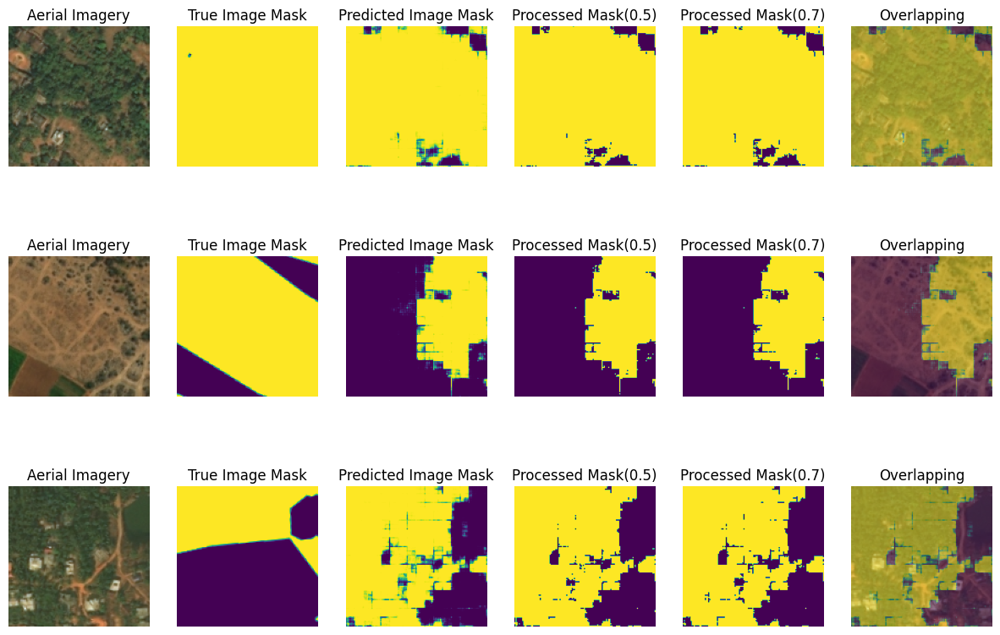

289/289 ━━━━━━━━━━━━━━━━━━━━ 13s 44ms/step - accuracy: 0.8116 - calculate_iou: 0.7494 - loss: 0.5435 - val_accuracy: 0.7786 - val_calculate_iou: 0.7127 - val_loss: 0.5521
Epoch 24/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/stepstep - accuracy: 0.8139 - calculate_iou: 0.7525 - loss: 0.542


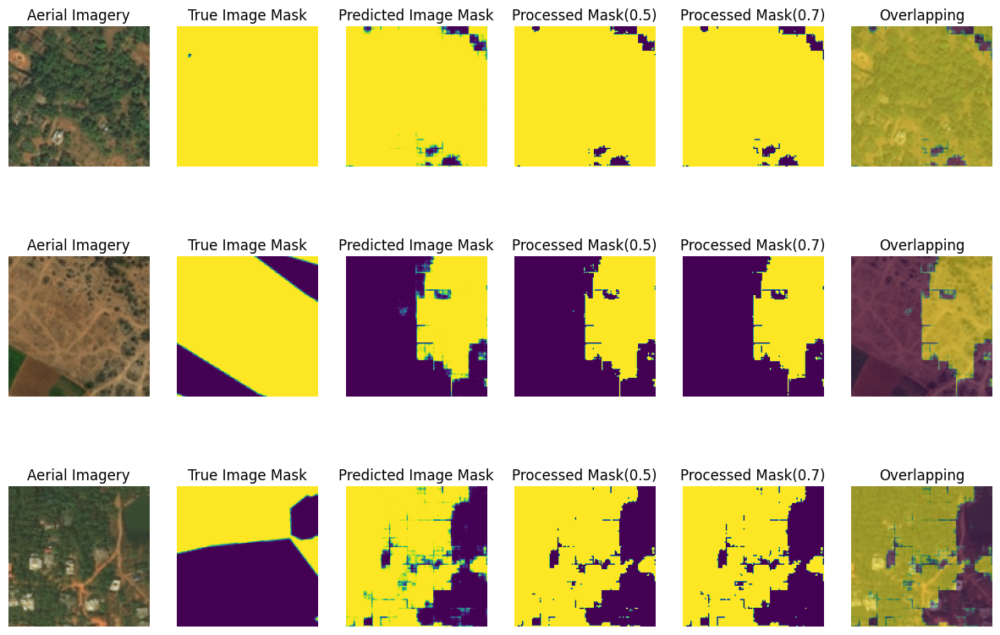

289/289 ━━━━━━━━━━━━━━━━━━━━ 12s 42ms/step - accuracy: 0.8140 - calculate_iou: 0.7526 - loss: 0.5424 - val_accuracy: 0.7813 - val_calculate_iou: 0.7173 - val_loss: 0.5515
Epoch 25/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/stepstep - accuracy: 0.8167 - calculate_iou: 0.7561 - loss: 0.541


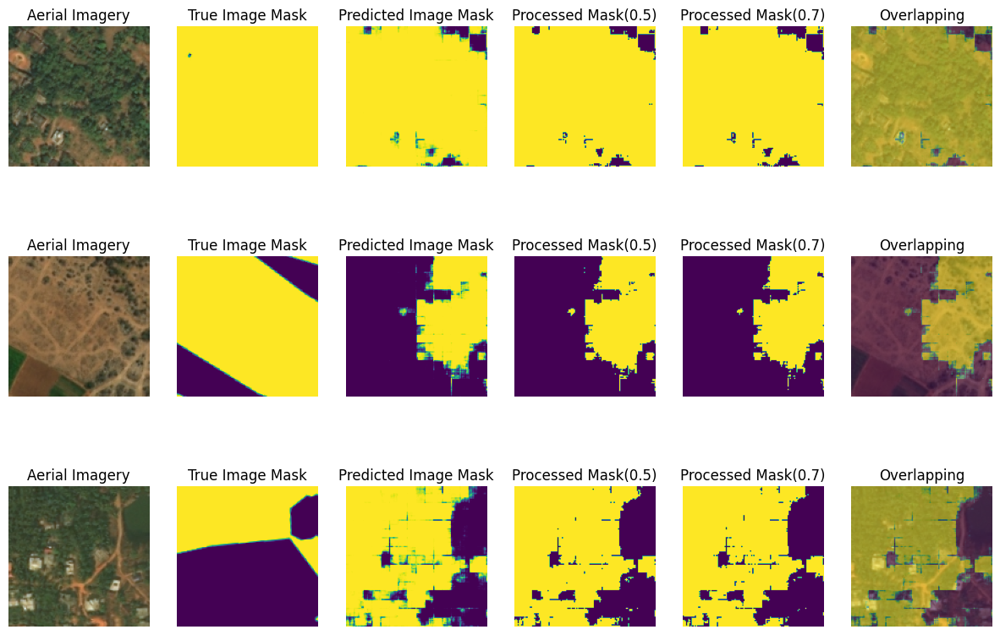

289/289 ━━━━━━━━━━━━━━━━━━━━ 12s 42ms/step - accuracy: 0.8167 - calculate_iou: 0.7562 - loss: 0.5411 - val_accuracy: 0.7769 - val_calculate_iou: 0.7103 - val_loss: 0.5528
Epoch 26/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/stepstep - accuracy: 0.8191 - calculate_iou: 0.7594 - loss: 0.539


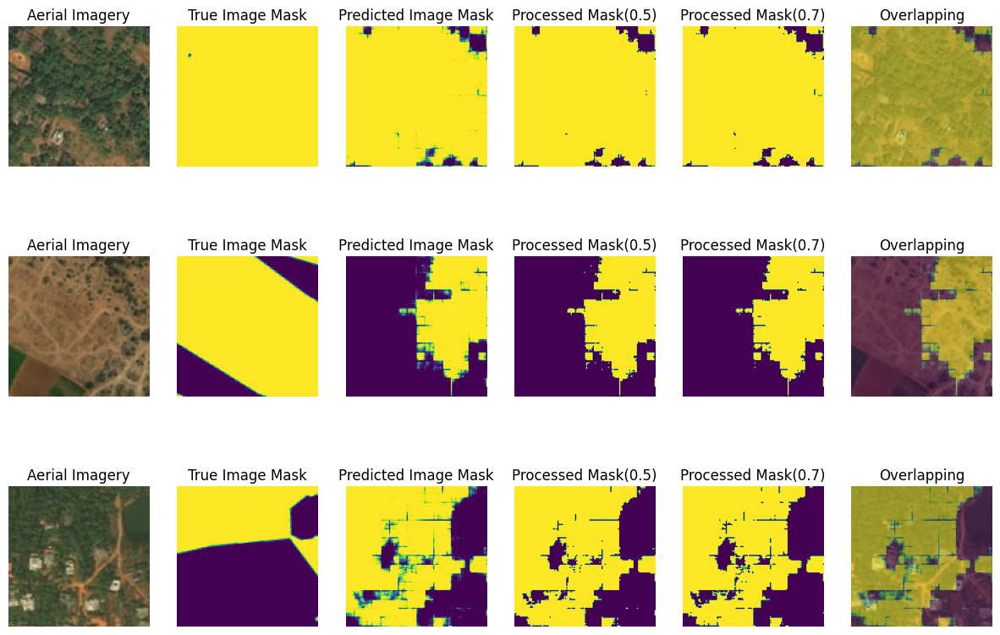

289/289 ━━━━━━━━━━━━━━━━━━━━ 12s 42ms/step - accuracy: 0.8192 - calculate_iou: 0.7595 - loss: 0.5399 - val_accuracy: 0.7762 - val_calculate_iou: 0.7090 - val_loss: 0.5528
Epoch 27/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/stepstep - accuracy: 0.8212 - calculate_iou: 0.7622 - loss: 0.539


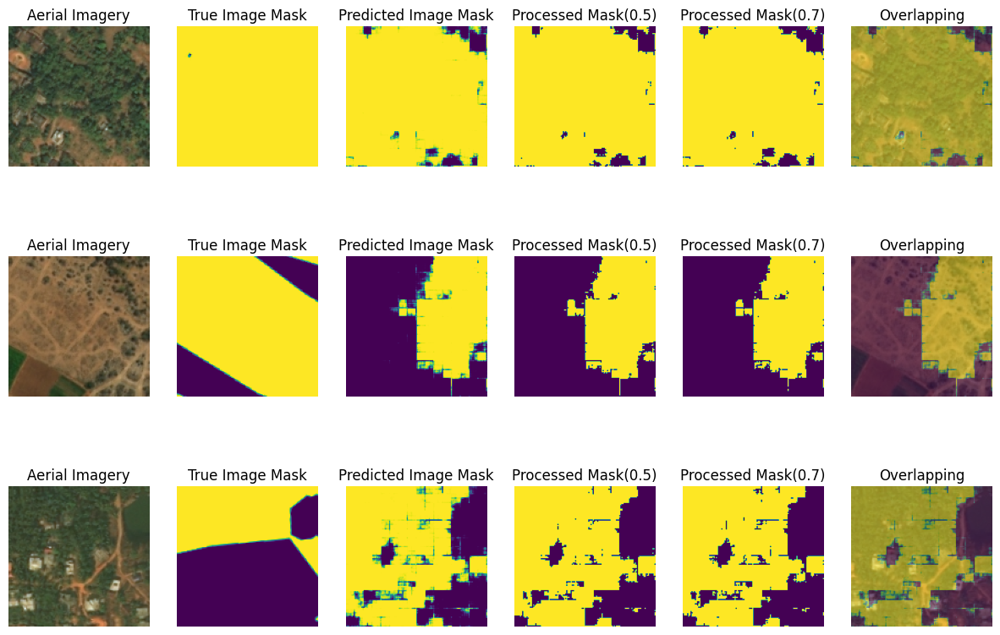

289/289 ━━━━━━━━━━━━━━━━━━━━ 13s 44ms/step - accuracy: 0.8212 - calculate_iou: 0.7623 - loss: 0.5390 - val_accuracy: 0.7768 - val_calculate_iou: 0.7097 - val_loss: 0.5525
Epoch 28/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/stepstep - accuracy: 0.8239 - calculate_iou: 0.7660 - loss: 0.537


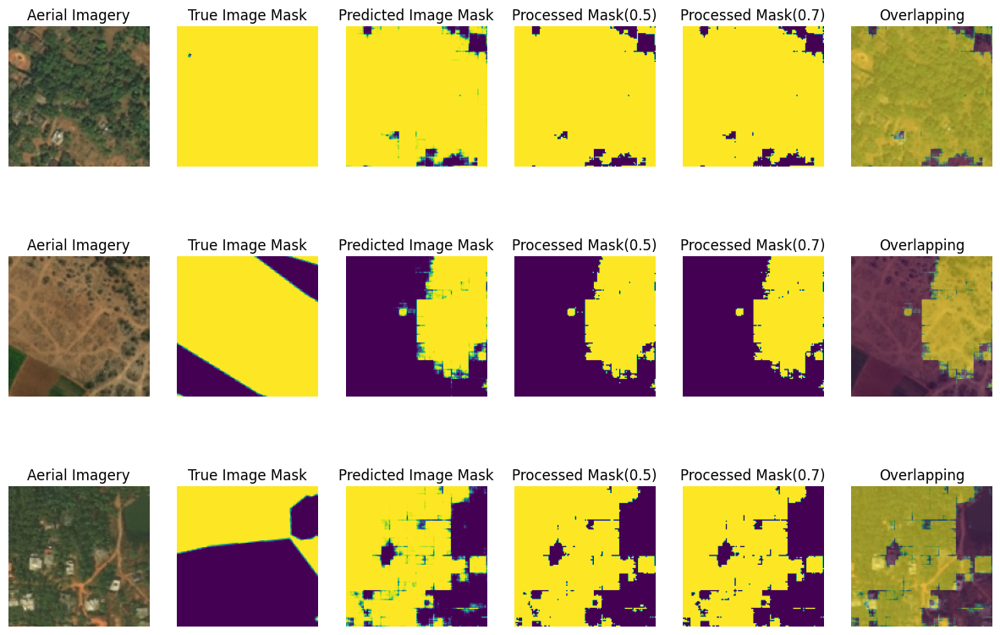

289/289 ━━━━━━━━━━━━━━━━━━━━ 12s 42ms/step - accuracy: 0.8239 - calculate_iou: 0.7660 - loss: 0.5376 - val_accuracy: 0.7774 - val_calculate_iou: 0.7102 - val_loss: 0.5522
Epoch 29/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/stepstep - accuracy: 0.8265 - calculate_iou: 0.7696 - loss: 0.536


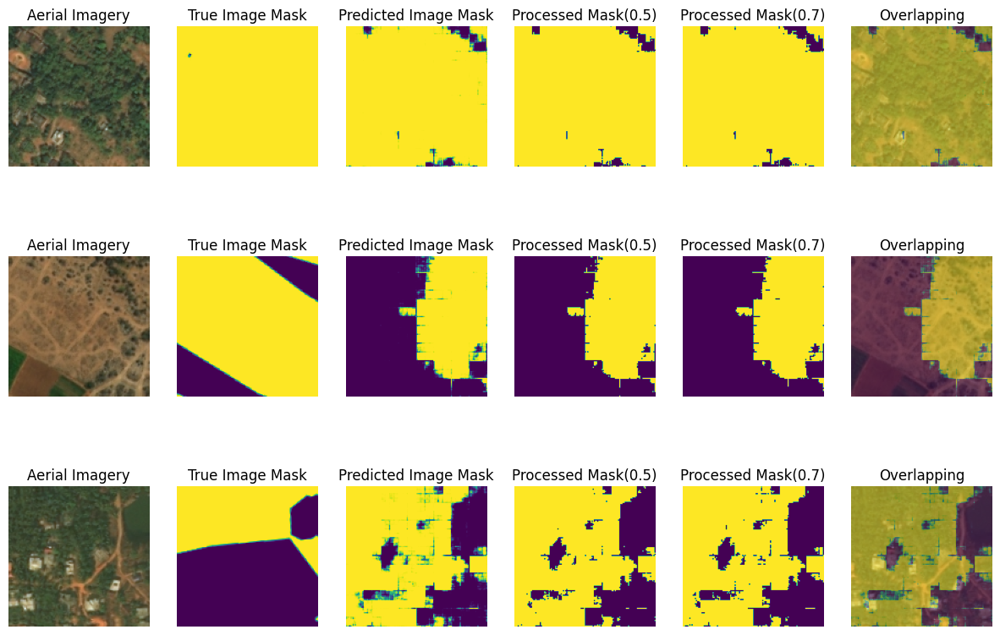

289/289 ━━━━━━━━━━━━━━━━━━━━ 12s 42ms/step - accuracy: 0.8265 - calculate_iou: 0.7696 - loss: 0.5364 - val_accuracy: 0.7795 - val_calculate_iou: 0.7146 - val_loss: 0.5521
Epoch 30/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/stepstep - accuracy: 0.8278 - calculate_iou: 0.7714 - loss: 0.535


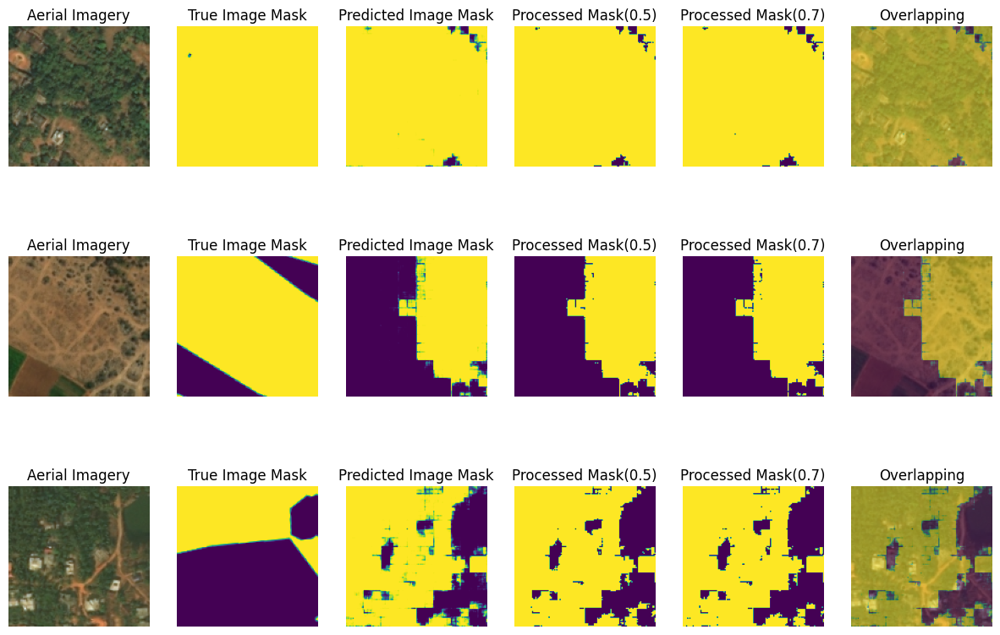

289/289 ━━━━━━━━━━━━━━━━━━━━ 12s 42ms/step - accuracy: 0.8278 - calculate_iou: 0.7714 - loss: 0.5356 - val_accuracy: 0.7881 - val_calculate_iou: 0.7310 - val_loss: 0.5515
Epoch 31/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/stepstep - accuracy: 0.8300 - calculate_iou: 0.7742 - loss: 0.534


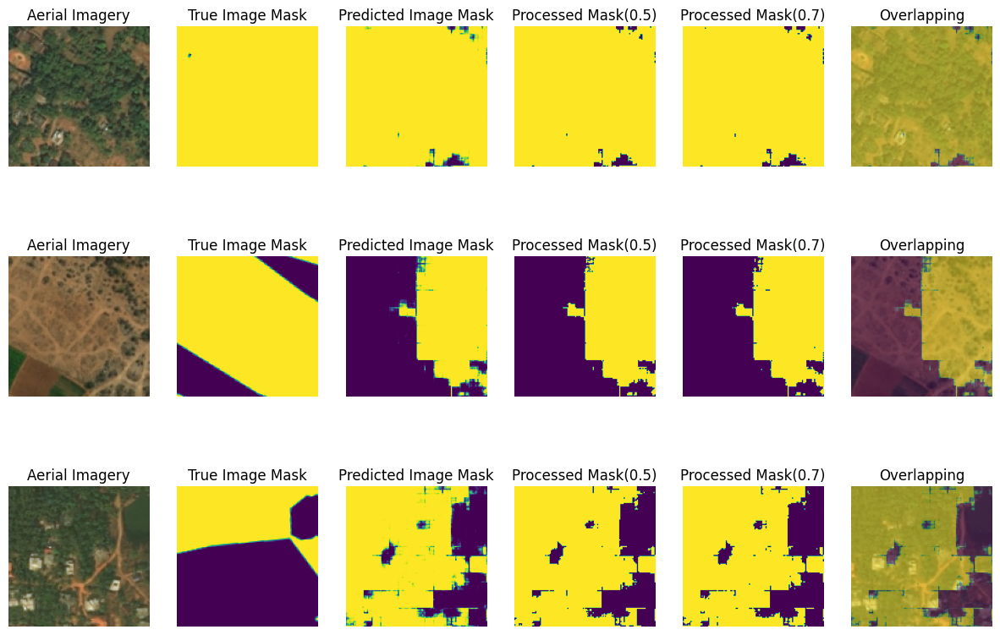

289/289 ━━━━━━━━━━━━━━━━━━━━ 12s 42ms/step - accuracy: 0.8300 - calculate_iou: 0.7743 - loss: 0.5346 - val_accuracy: 0.7885 - val_calculate_iou: 0.7330 - val_loss: 0.5522
Epoch 32/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/stepstep - accuracy: 0.8324 - calculate_iou: 0.7775 - loss: 0.533


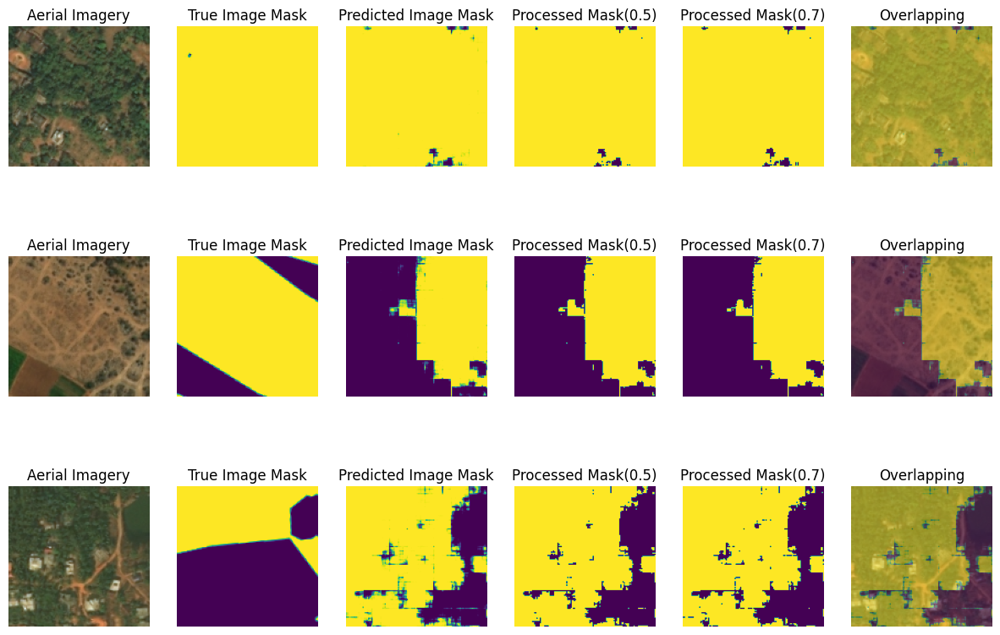

289/289 ━━━━━━━━━━━━━━━━━━━━ 13s 43ms/step - accuracy: 0.8324 - calculate_iou: 0.7776 - loss: 0.5335 - val_accuracy: 0.7896 - val_calculate_iou: 0.7355 - val_loss: 0.5524
Epoch 33/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/stepstep - accuracy: 0.8337 - calculate_iou: 0.7795 - loss: 0.532


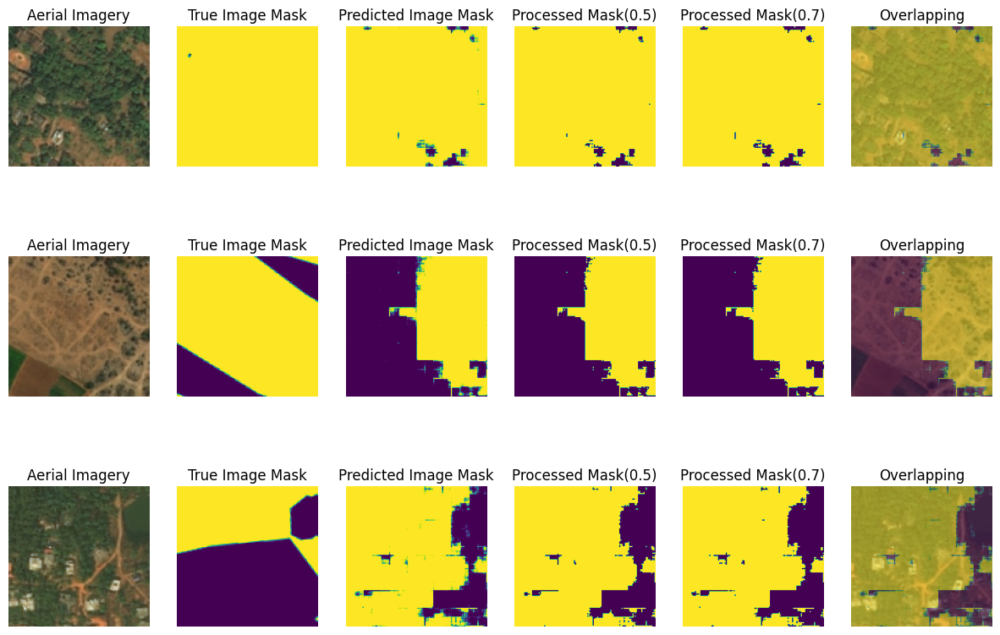

289/289 ━━━━━━━━━━━━━━━━━━━━ 12s 42ms/step - accuracy: 0.8337 - calculate_iou: 0.7795 - loss: 0.5329 - val_accuracy: 0.7880 - val_calculate_iou: 0.7326 - val_loss: 0.5526
Epoch 34/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/stepstep - accuracy: 0.8353 - calculate_iou: 0.7817 - loss: 0.532


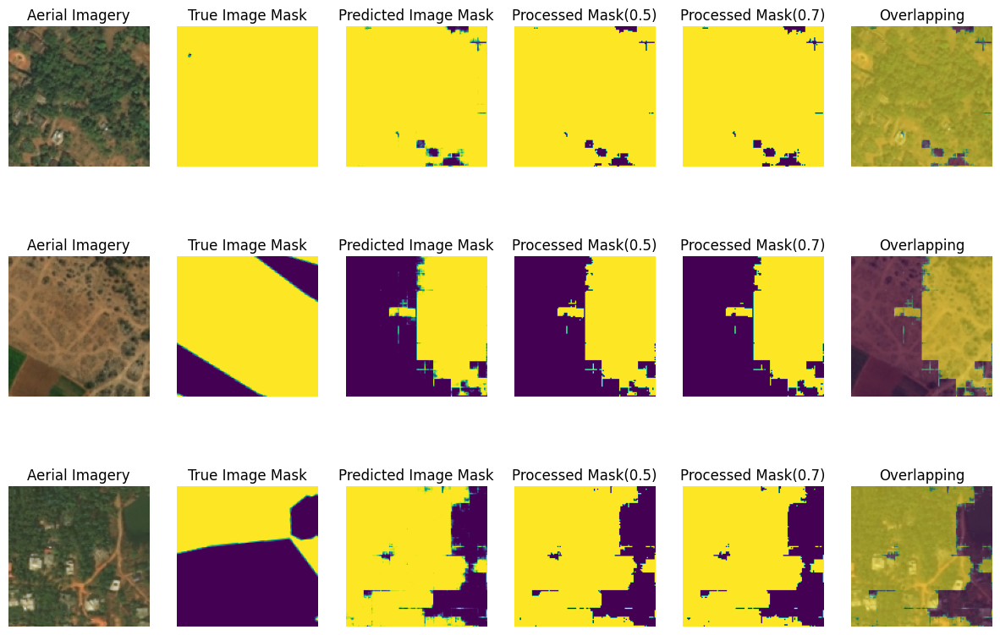

289/289 ━━━━━━━━━━━━━━━━━━━━ 12s 42ms/step - accuracy: 0.8354 - calculate_iou: 0.7817 - loss: 0.5321 - val_accuracy: 0.7903 - val_calculate_iou: 0.7363 - val_loss: 0.5520
Epoch 35/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/stepstep - accuracy: 0.8383 - calculate_iou: 0.7858 - loss: 0.530


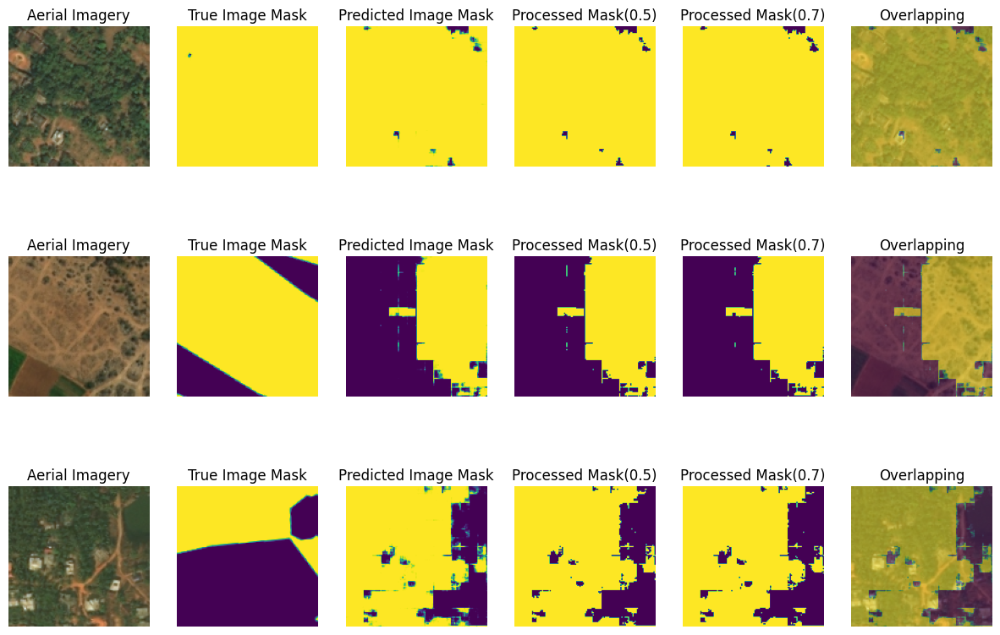

289/289 ━━━━━━━━━━━━━━━━━━━━ 12s 42ms/step - accuracy: 0.8383 - calculate_iou: 0.7858 - loss: 0.5307 - val_accuracy: 0.7916 - val_calculate_iou: 0.7397 - val_loss: 0.5526
Epoch 36/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/stepstep - accuracy: 0.8405 - calculate_iou: 0.7889 - loss: 0.529


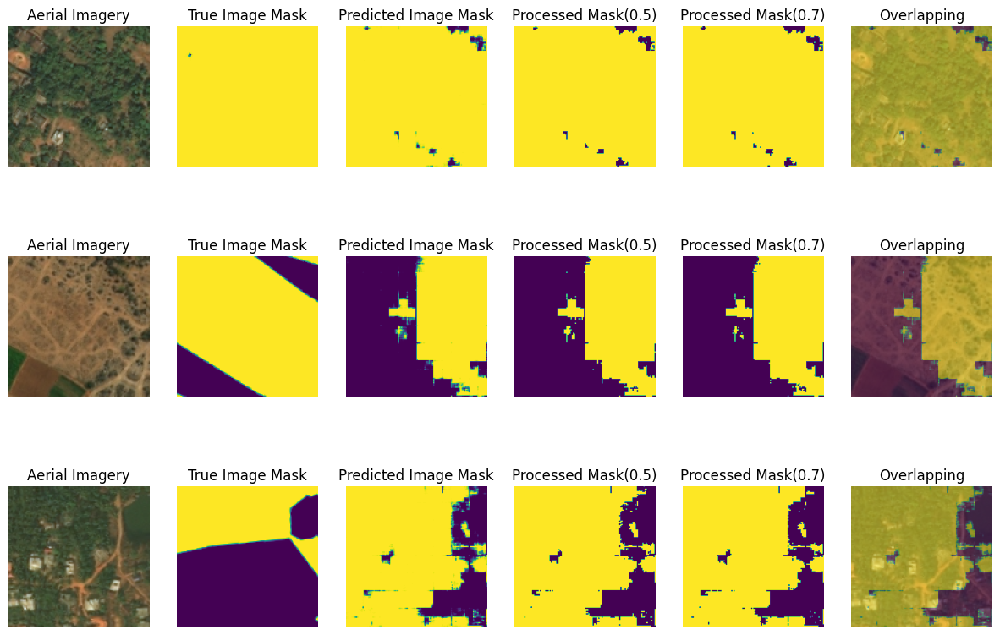

289/289 ━━━━━━━━━━━━━━━━━━━━ 12s 41ms/step - accuracy: 0.8406 - calculate_iou: 0.7889 - loss: 0.5296 - val_accuracy: 0.7919 - val_calculate_iou: 0.7413 - val_loss: 0.5531
Epoch 37/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/stepstep - accuracy: 0.8425 - calculate_iou: 0.7915 - loss: 0.528


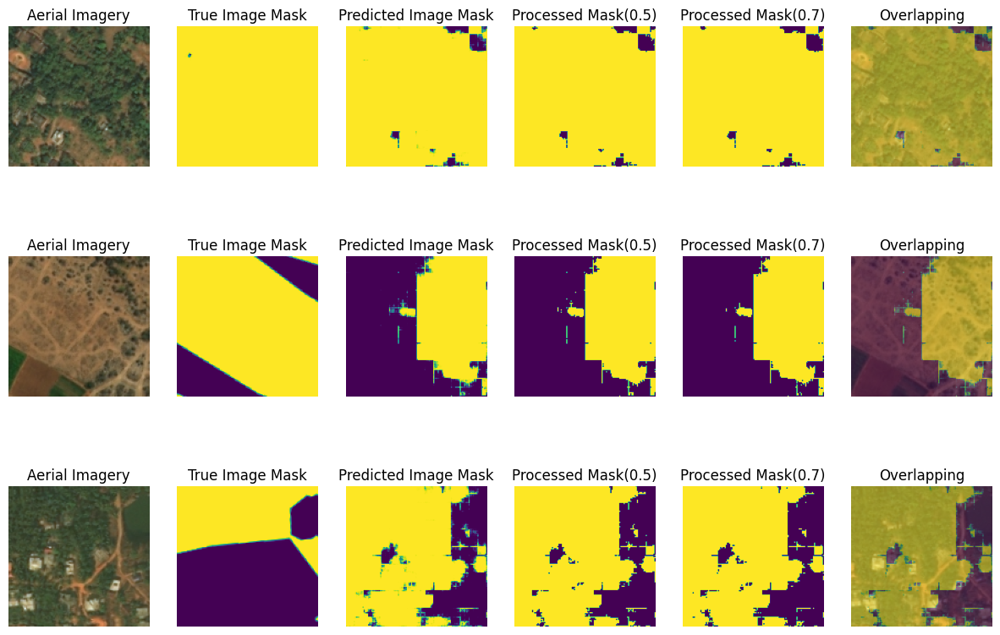

289/289 ━━━━━━━━━━━━━━━━━━━━ 12s 43ms/step - accuracy: 0.8425 - calculate_iou: 0.7916 - loss: 0.5287 - val_accuracy: 0.7899 - val_calculate_iou: 0.7363 - val_loss: 0.5525
Epoch 38/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/stepstep - accuracy: 0.8454 - calculate_iou: 0.7957 - loss: 0.527


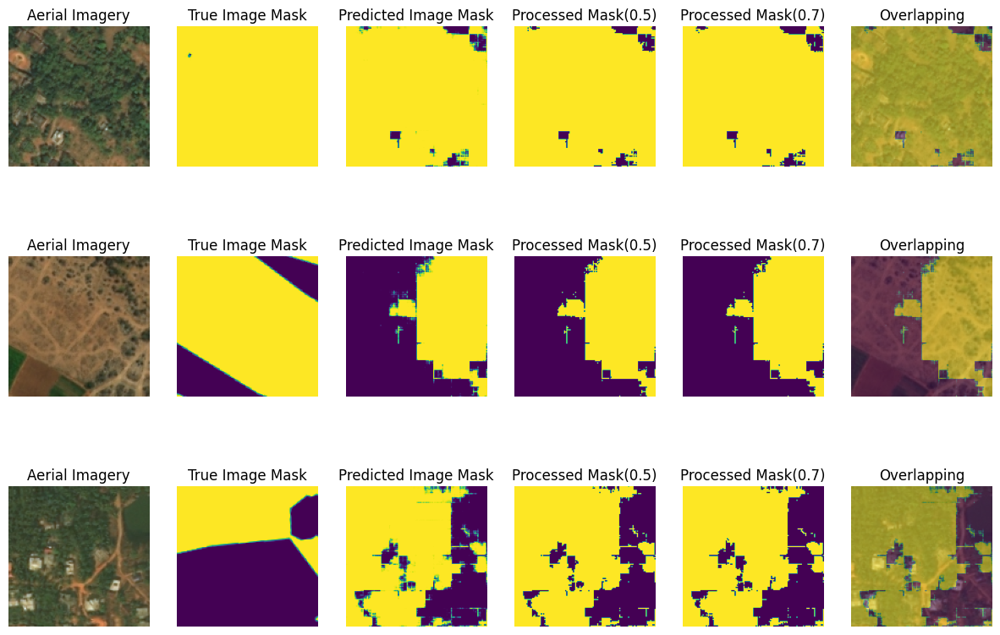

289/289 ━━━━━━━━━━━━━━━━━━━━ 12s 42ms/step - accuracy: 0.8454 - calculate_iou: 0.7957 - loss: 0.5273 - val_accuracy: 0.7894 - val_calculate_iou: 0.7354 - val_loss: 0.5525
Epoch 39/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/stepstep - accuracy: 0.8472 - calculate_iou: 0.7982 - loss: 0.526


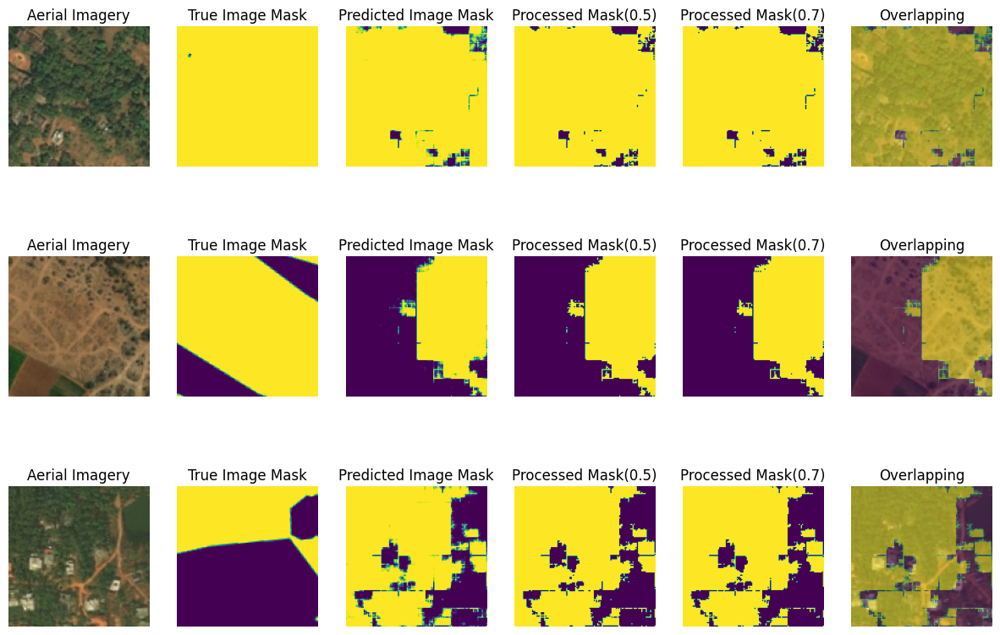

289/289 ━━━━━━━━━━━━━━━━━━━━ 12s 42ms/step - accuracy: 0.8472 - calculate_iou: 0.7982 - loss: 0.5264 - val_accuracy: 0.7860 - val_calculate_iou: 0.7299 - val_loss: 0.5533
Epoch 40/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/stepstep - accuracy: 0.8490 - calculate_iou: 0.8008 - loss: 0.525


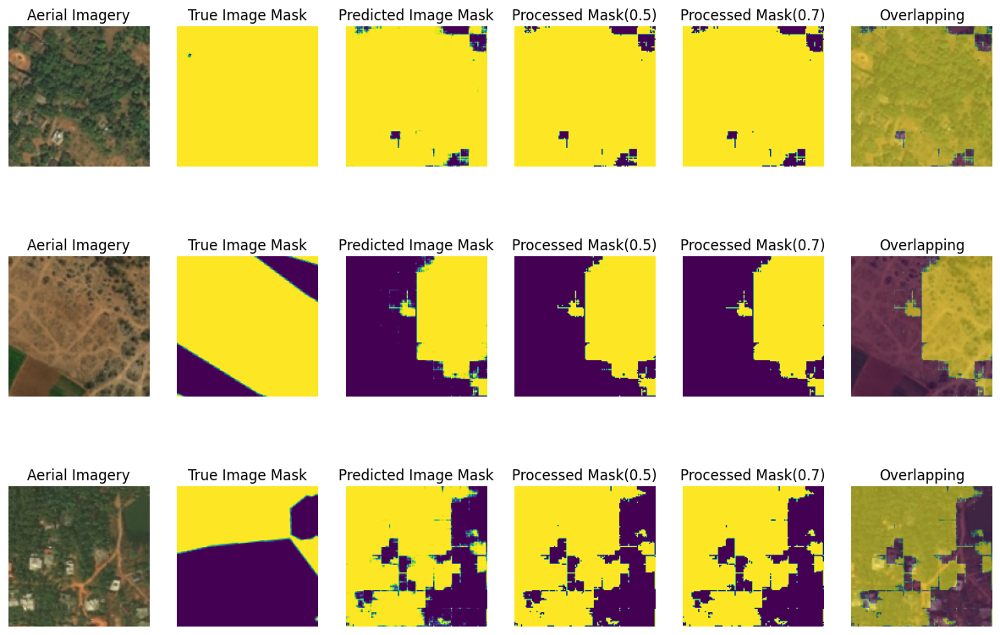

289/289 ━━━━━━━━━━━━━━━━━━━━ 12s 42ms/step - accuracy: 0.8490 - calculate_iou: 0.8008 - loss: 0.5255 - val_accuracy: 0.7872 - val_calculate_iou: 0.7290 - val_loss: 0.5514
Epoch 41/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/stepstep - accuracy: 0.8516 - calculate_iou: 0.8045 - loss: 0.524


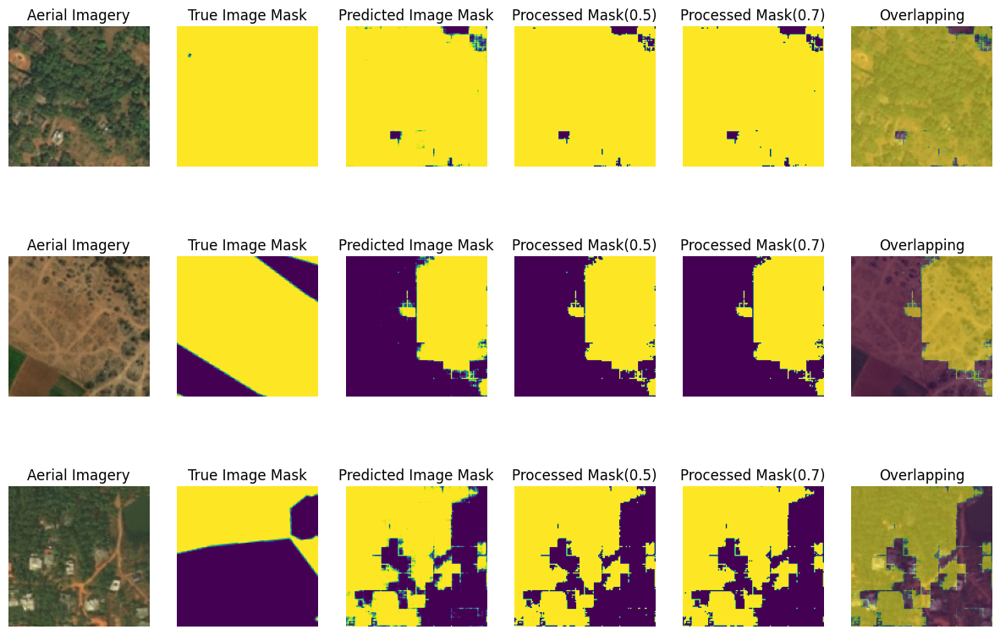

289/289 ━━━━━━━━━━━━━━━━━━━━ 12s 42ms/step - accuracy: 0.8516 - calculate_iou: 0.8046 - loss: 0.5242 - val_accuracy: 0.7876 - val_calculate_iou: 0.7297 - val_loss: 0.5513
Epoch 42/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/stepstep - accuracy: 0.8530 - calculate_iou: 0.8064 - loss: 0.523


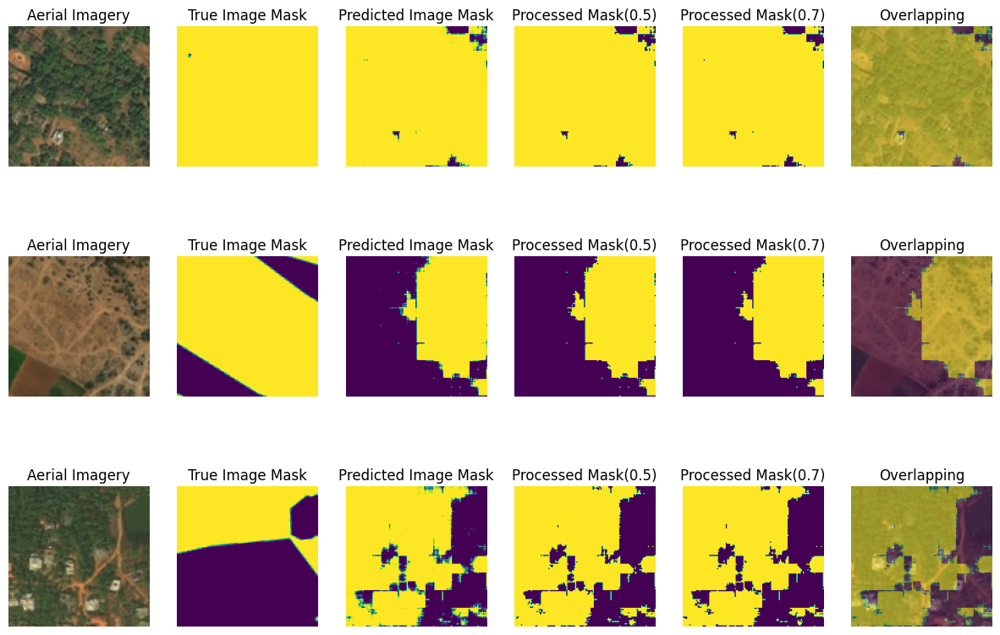

289/289 ━━━━━━━━━━━━━━━━━━━━ 13s 44ms/step - accuracy: 0.8530 - calculate_iou: 0.8064 - loss: 0.5235 - val_accuracy: 0.7879 - val_calculate_iou: 0.7301 - val_loss: 0.5512
Epoch 43/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/stepstep - accuracy: 0.8548 - calculate_iou: 0.8090 - loss: 0.522


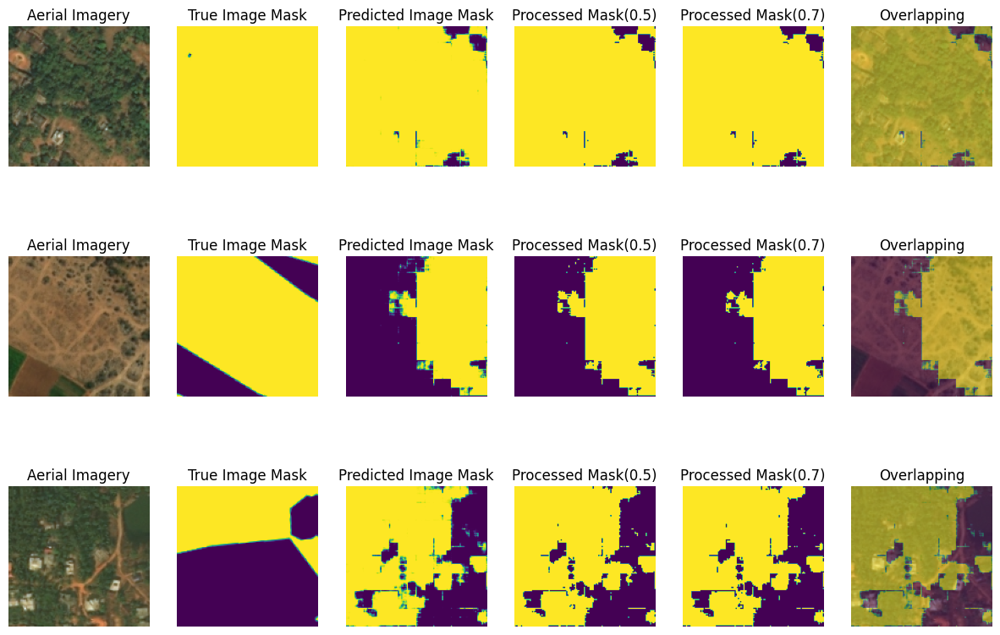

289/289 ━━━━━━━━━━━━━━━━━━━━ 12s 42ms/step - accuracy: 0.8549 - calculate_iou: 0.8090 - loss: 0.5226 - val_accuracy: 0.7860 - val_calculate_iou: 0.7249 - val_loss: 0.5504
Epoch 44/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/stepstep - accuracy: 0.8557 - calculate_iou: 0.8103 - loss: 0.522


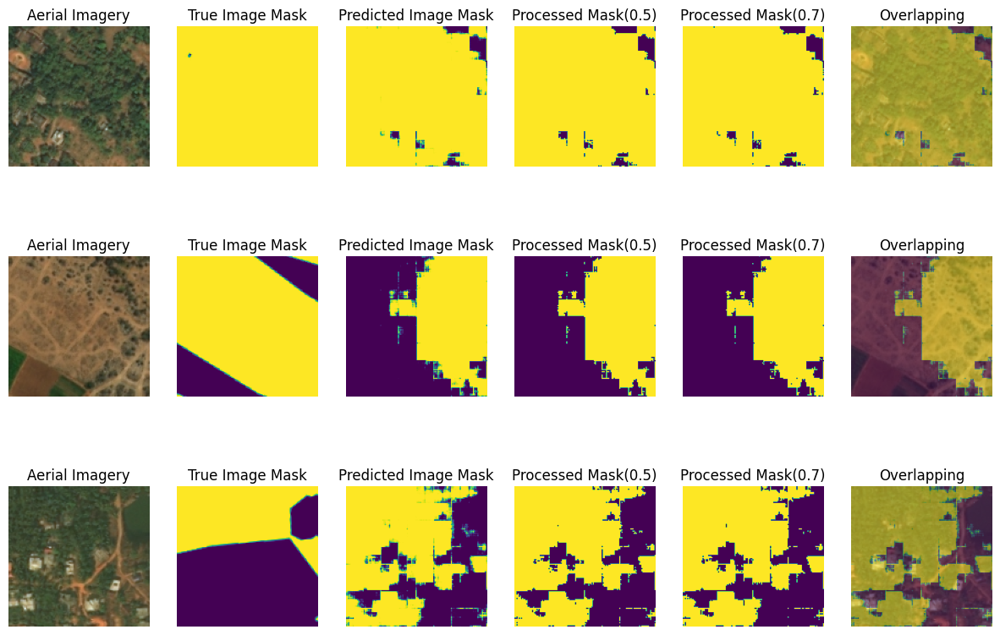

289/289 ━━━━━━━━━━━━━━━━━━━━ 12s 42ms/step - accuracy: 0.8558 - calculate_iou: 0.8104 - loss: 0.5222 - val_accuracy: 0.7864 - val_calculate_iou: 0.7267 - val_loss: 0.5509
Epoch 45/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/stepstep - accuracy: 0.8572 - calculate_iou: 0.8123 - loss: 0.521


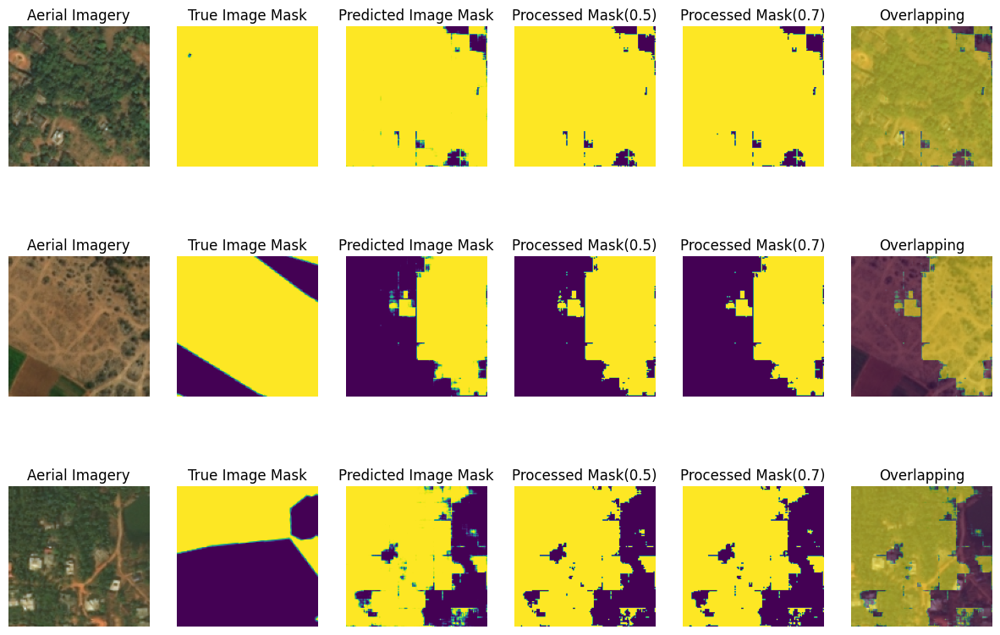

289/289 ━━━━━━━━━━━━━━━━━━━━ 12s 42ms/step - accuracy: 0.8572 - calculate_iou: 0.8124 - loss: 0.5215 - val_accuracy: 0.7849 - val_calculate_iou: 0.7233 - val_loss: 0.5509
Epoch 46/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/stepstep - accuracy: 0.8595 - calculate_iou: 0.8157 - loss: 0.520


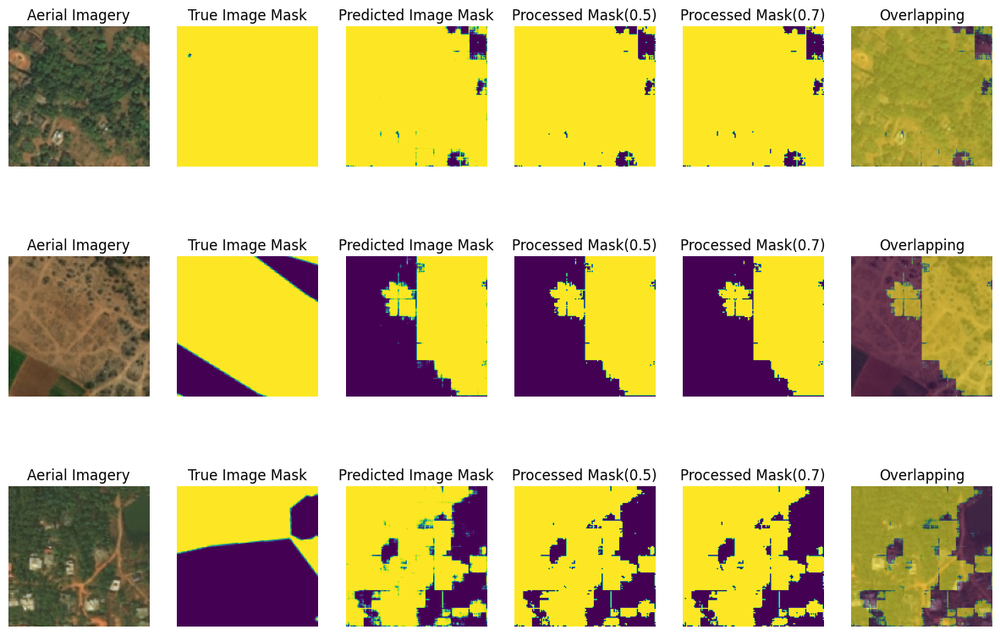

289/289 ━━━━━━━━━━━━━━━━━━━━ 12s 41ms/step - accuracy: 0.8595 - calculate_iou: 0.8157 - loss: 0.5203 - val_accuracy: 0.7826 - val_calculate_iou: 0.7223 - val_loss: 0.5531
Epoch 47/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/stepstep - accuracy: 0.8606 - calculate_iou: 0.8171 - loss: 0.519


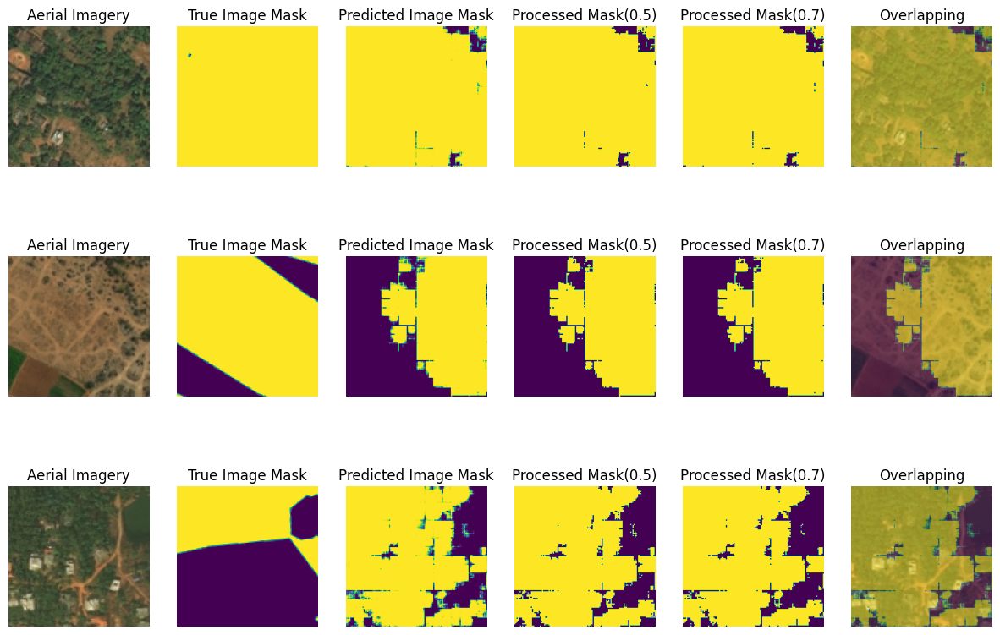

289/289 ━━━━━━━━━━━━━━━━━━━━ 13s 43ms/step - accuracy: 0.8606 - calculate_iou: 0.8171 - loss: 0.5198 - val_accuracy: 0.7863 - val_calculate_iou: 0.7322 - val_loss: 0.5546
Epoch 48/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/stepstep - accuracy: 0.8620 - calculate_iou: 0.8192 - loss: 0.519


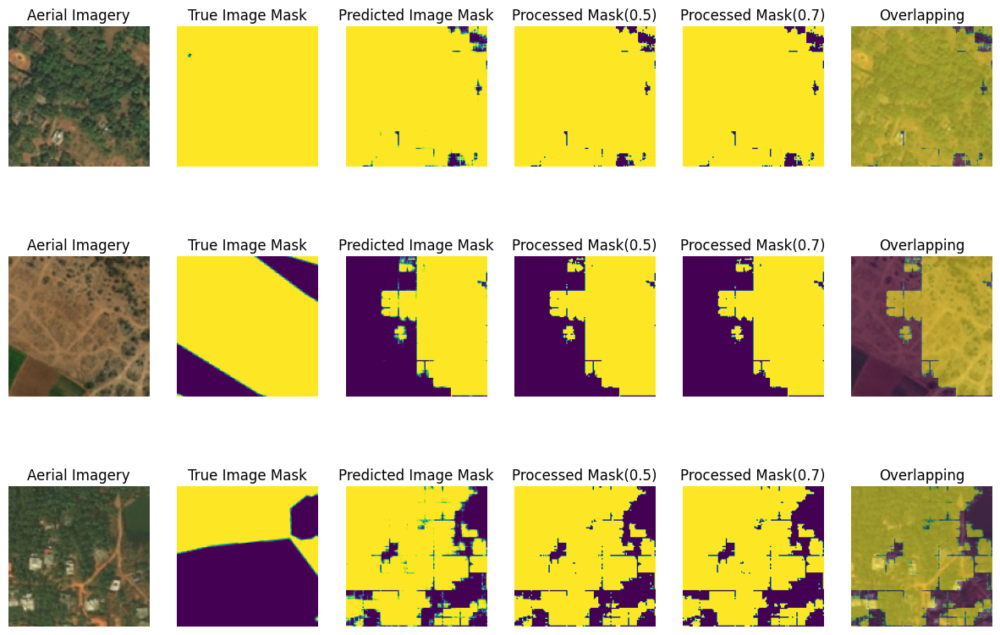

289/289 ━━━━━━━━━━━━━━━━━━━━ 12s 42ms/step - accuracy: 0.8620 - calculate_iou: 0.8192 - loss: 0.5191 - val_accuracy: 0.7854 - val_calculate_iou: 0.7299 - val_loss: 0.5543
Epoch 49/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/stepstep - accuracy: 0.8641 - calculate_iou: 0.8223 - loss: 0.518


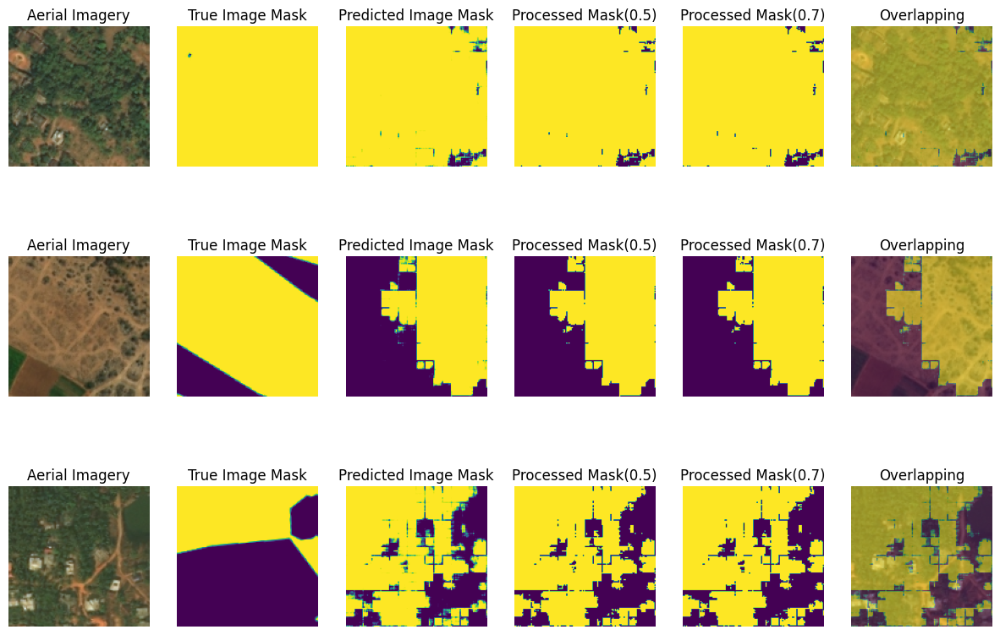

289/289 ━━━━━━━━━━━━━━━━━━━━ 12s 42ms/step - accuracy: 0.8641 - calculate_iou: 0.8223 - loss: 0.5182 - val_accuracy: 0.7845 - val_calculate_iou: 0.7294 - val_loss: 0.5552
Epoch 50/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/stepstep - accuracy: 0.8659 - calculate_iou: 0.8248 - loss: 0.517


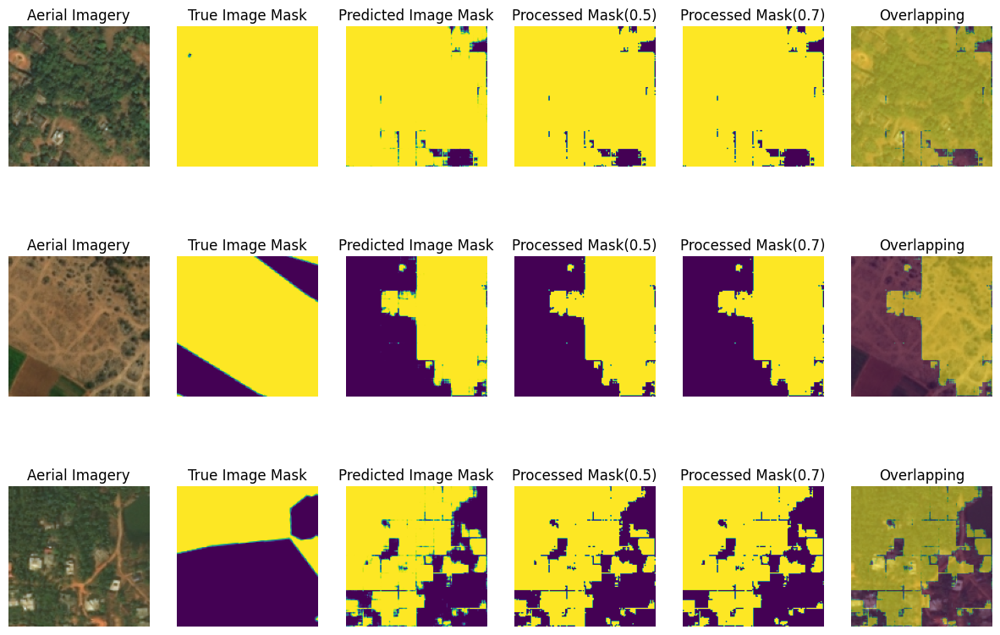

289/289 ━━━━━━━━━━━━━━━━━━━━ 12s 42ms/step - accuracy: 0.8659 - calculate_iou: 0.8249 - loss: 0.5173 - val_accuracy: 0.7853 - val_calculate_iou: 0.7272 - val_loss: 0.5526


In [40]:
# Model Compilation
model.compile(
    loss=partial_cross_entropy,
    optimizer=keras.optimizers.Adam(learning_rate=1e-3),
    metrics=['accuracy', calculate_iou]
)

# Training Configs
steps_per_epoch = train_samples//BATCH_SIZE
train_ds = train_ds.repeat()

# Model Training
history = model.fit(
    train_ds,
    steps_per_epoch=steps_per_epoch,
    validation_data=valid_ds,
    epochs=50,
    callbacks=[ShowImageMasksCallback(valid_ds)]
)




In [41]:
print('saving model...')
model.save('aerial_forest_segment.h5')
print('model saved.')

saving model...
model saved.
